# Retinal Vessel

The retinal vessel segmentation is a binary image segmentation. Currently there are 4 well used dataset are available for this task. [HERE](https://www.kaggle.com/ipythonx/retinal-vessel-segmentation) is the dataset all together. 

```
CHASE DB1
DRIVE
HRF
STARE
```

In this starter notebook, we will explore all of them but additionally we will run a simple segmentation model on **DRIVE** dataset only. Rest of the datasets are pretty same format and should be easy to run.

In [1]:
!pip install -U -q segmentation-models --user

from PIL import Image
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
os.environ["SM_FRAMEWORK"] = "tf.keras"

import segmentation_models as sm
import matplotlib.pyplot as plt 
import tensorflow_io as tfio
import tensorflow as tf
from sklearn.model_selection import train_test_split


root = '../input/retinal-vessel-segmentation'
exts = ('jpg', 'JPG', 'png', 'PNG', 'tif', 'gif', 'ppm')

Segmentation Models: using `tf.keras` framework.


# DRIVE

The dataset comes with pair of input retina image and target mask. Among all retina image, we will only use this dataset for a quick baseline. However, rest of the dataset can be replaces easily on this pipeline.


## Preprocessing Images

In [2]:
def restrict_normalized(imgs):
    imgs_normalized = np.empty(imgs.shape)
    imgs_std = np.std(imgs)
    imgs_mean = np.mean(imgs)
    imgs_normalized = (imgs-imgs_mean)/imgs_std
    imgs_normalized = ((imgs_normalized - np.min(imgs_normalized)) / (np.max(imgs_normalized)-np.min(imgs_normalized)))*255
    return imgs_normalized

# CLAHE (Contrast Limited Adaptive Histogram Equalization)
#adaptive histogram equalization is used. In this, image is divided into small blocks called "tiles" (tileSize is 8x8 by default in OpenCV). Then each of these blocks are histogram equalized as usual. So in a small area, histogram would confine to a small region (unless there is noise). If noise is there, it will be amplified. To avoid this, contrast limiting is applied. If any histogram bin is above the specified contrast limit (by default 40 in OpenCV), those pixels are clipped and distributed uniformly to other bins before applying histogram equalization. After equalization, to remove artifacts in tile borders, bilinear interpolation is applied
def clahe_equalized(imgs):
  clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(16,16))
  imgs_equalized = np.empty(imgs.shape)
  imgs_equalized = clahe.apply(np.array(imgs, dtype = np.uint8))
  return imgs_equalized

def normalized(imgs):
  imgs_normalized =np.empty(imgs.shape)
  imgs_normalized =cv2.equalizeHist(imgs)
  return imgs_normalized

def adjust_gamma(imgs, gamma=1.0):
  invGamma = 1.0 / gamma
  table = np.array([((i / 255.0) ** invGamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
  # apply gamma correction using the lookup table
  new_imgs = np.empty(imgs.shape)
  new_imgs = cv2.LUT(np.array(imgs, dtype = np.uint8), table)
  return new_imgs

def expand(image):
  arr = np.zeros(image.shape + (3,))
  arr[:,:,0] = image[:,:]
  arr[:,:,1] = image[:,:]
  arr[:,:,2] = image[:,:]
  return arr

def preprocess(image):
  image=restrict_normalized(image)
  image=clahe_equalized(image)
  image=adjust_gamma(image,1.2)
  image=image/255.0
  image=expand(image)
  return image

In [3]:
import cv2
from PIL import Image

processed_path = './Processed_images_Drive'

os.mkdir(path=processed_path)
directory = '../input/retinal-vessel-segmentation/DRIVE/training/images/'
for fname in os.listdir(directory):
    image = plt.imread(directory + fname)
    image = image[:,:,1]
    processed_img = preprocess(image)
    print(processed_img.shape)
    processed_img = Image.fromarray((processed_img * 255).astype(np.uint8))
    processed_img.save(processed_path + '/' + fname)

(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)
(584, 565, 3)


In [4]:
input_data = os.path.join('./', 'Processed_images_Drive')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir('./Processed_images_Drive')
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


target_data = os.path.join(root, 'DRIVE/training/1st_manual')
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

print("Number of samples:", len(images), len(masks))
for input_path, target_path in zip(images[:10], masks[:10]):
    print(input_path[-31:], "|", target_path[-34:])

Number of samples: 20 20
ed_images_Drive/21_training.tif | training/1st_manual/21_manual1.gif
ed_images_Drive/22_training.tif | training/1st_manual/22_manual1.gif
ed_images_Drive/23_training.tif | training/1st_manual/23_manual1.gif
ed_images_Drive/24_training.tif | training/1st_manual/24_manual1.gif
ed_images_Drive/25_training.tif | training/1st_manual/25_manual1.gif
ed_images_Drive/26_training.tif | training/1st_manual/26_manual1.gif
ed_images_Drive/27_training.tif | training/1st_manual/27_manual1.gif
ed_images_Drive/28_training.tif | training/1st_manual/28_manual1.gif
ed_images_Drive/29_training.tif | training/1st_manual/29_manual1.gif
ed_images_Drive/30_training.tif | training/1st_manual/30_manual1.gif


(584, 565, 3)


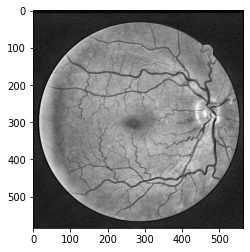

In [5]:
imagesss = cv2.imread('./Processed_images_Drive/22_training.tif')
print(imagesss.shape)
plt.imshow(imagesss)

In [6]:
IMAGE_SIZE = 512
BATCH_SIZE = 12

def read_files(image_path, mask=False):
    image = tf.io.read_file(image_path)
    if mask:
        image = tf.io.decode_gif(image) # out: (1, h, w, 3)
        image = tf.squeeze(image) # out: (h, w, 3)
        image = tf.image.rgb_to_grayscale(image) # out: (h, w, 1)
        image = tf.divide(image, 128)
        image.set_shape([None, None, 1])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = tf.cast(image, tf.int32)
    else:
        image = tfio.experimental.image.decode_tiff(image) # out: (h, w, 4)
        image = image[:,:,:3] # out: (h, w, 3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.
    return image

def load_data(image_list, mask_list):
    image = read_files(image_list)
    mask  = read_files(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset1 = dataset.take(15)
    dataset2 = dataset.skip(15)
    dataset1 = dataset1.batch(BATCH_SIZE, drop_remainder=False)
    dataset2 = dataset2.batch(2, drop_remainder=False)
    return dataset1, dataset2

train_dataset, valid_dataset = data_generator(images, masks)
train_dataset, valid_dataset

(<BatchDataset shapes: ((None, 512, 512, 3), (None, 512, 512, 1)), types: (tf.float32, tf.int32)>,
 <BatchDataset shapes: ((None, 512, 512, 3), (None, 512, 512, 1)), types: (tf.float32, tf.int32)>)

In [7]:
def visualize(**images):
    """PLot images in one row."""
    n = len(images) 
    plt.figure(figsize=(20, 20))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image, cmap='gray')
    plt.show()

(12, 512, 512, 3) (12, 512, 512, 1)
0 1
[0 1]


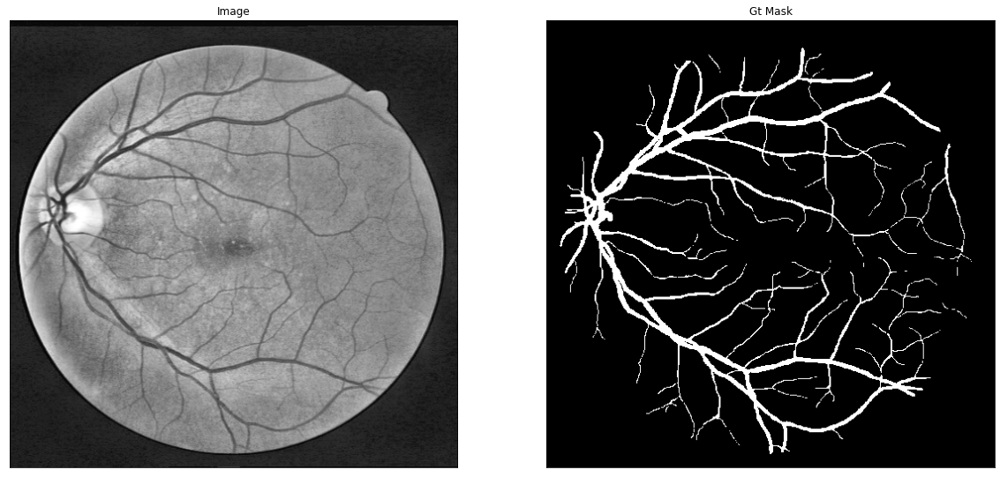

0 1
[0 1]


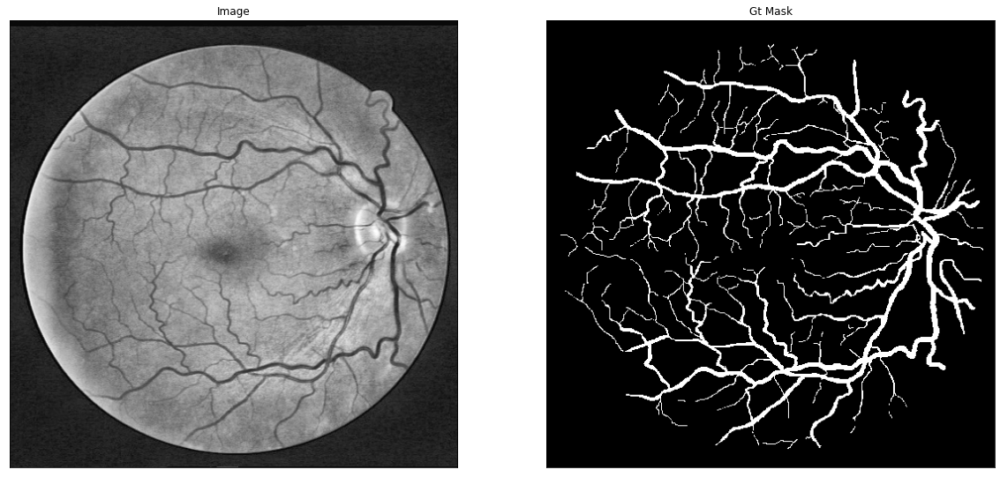

0 1
[0 1]


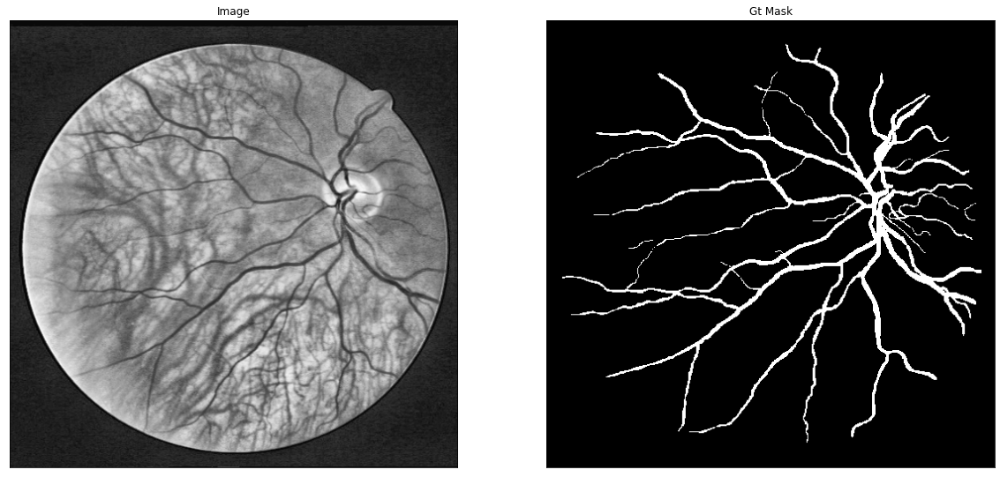

0 1
[0 1]


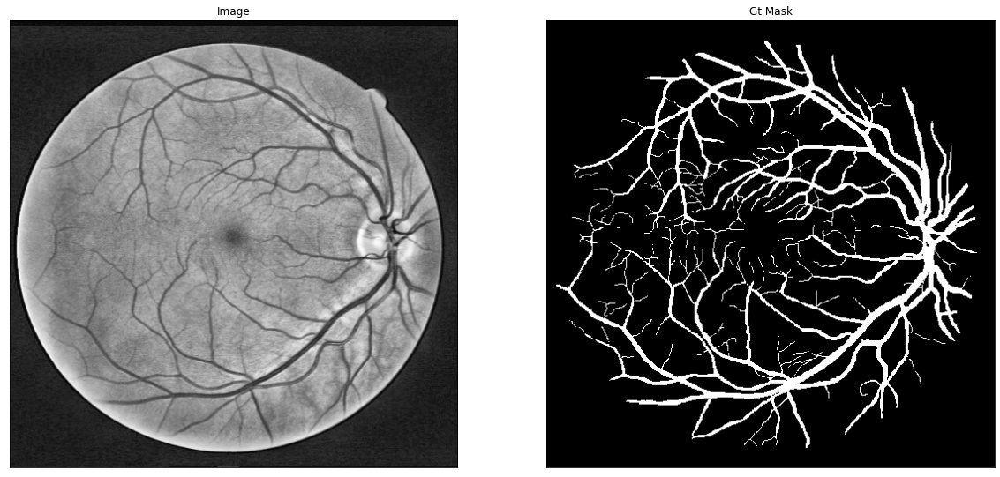

0 1
[0 1]


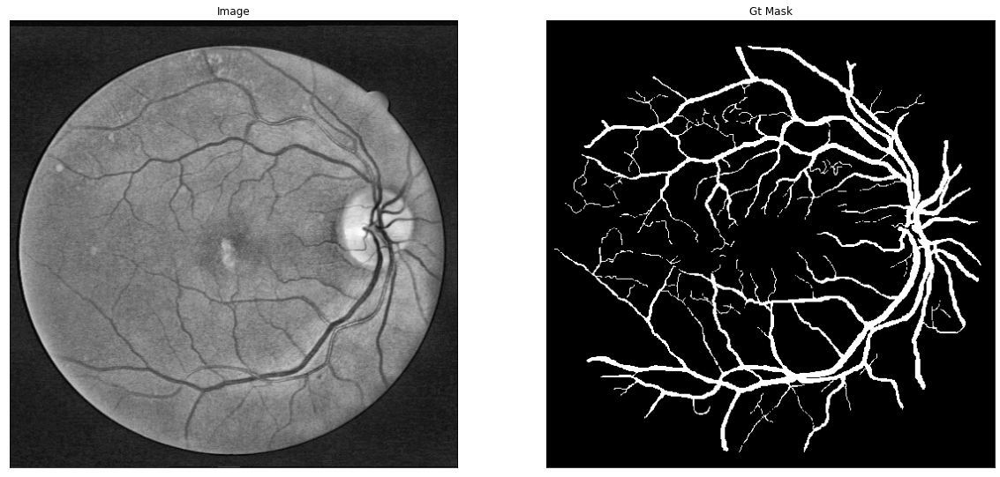

In [8]:
image, mask = next(iter(train_dataset.take(1))) 
print(image.shape, mask.shape)

for (img, msk) in zip(image[:5], mask[:5]):
    print(mask.numpy().min(), mask.numpy().max())
    print(np.unique(mask.numpy()))
    visualize(
        image=img.numpy(),
        gt_mask=msk.numpy(),
    )

# Model

In [9]:
from tensorflow import keras 

# Free up RAM in case the model definition cells were run multiple times
keras.backend.clear_session()
BACKBONE   = 'vgg19'
n_classes  = 1 
activation = 'sigmoid' 
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
model.summary(line_length=110)

80150528/80134624 [==============================] - 4s 0us/step
Model: "model"
______________________________________________________________________________________________________________
Layer (type)                        Output Shape            Param #      Connected to                         
input_1 (InputLayer)                [(None, None, None, 3)] 0                                                 
______________________________________________________________________________________________________________
block1_conv1 (Conv2D)               (None, None, None, 64)  1792         input_1[0][0]                        
______________________________________________________________________________________________________________
block1_conv2 (Conv2D)               (None, None, None, 64)  36928        block1_conv1[0][0]                   
______________________________________________________________________________________________________________
block1_pool (MaxPooling2D)      

# Callback : Monitoring Training Progress

In [10]:
class DisplayCallback(keras.callbacks.Callback):
    def __init__(self, dataset, epoch_interval=5):
        self.dataset = dataset
        self.epoch_interval = epoch_interval
    
    def display(self, display_list, extra_title=''):
        plt.figure(figsize=(15, 15))
        title = ['Input Image', 'True Mask', 'Predicted Mask']

        if len(display_list) > len(title):
            title.append(extra_title)

        for i in range(len(display_list)):
            plt.subplot(1, len(display_list), i+1)
            plt.title(title[i])
            plt.imshow(display_list[i], cmap='gray')
            plt.axis('off')
        plt.show()
        
    def create_mask(self, pred_mask):
        pred_mask = (pred_mask > 0.5).astype("int32")
        return pred_mask[0]
    
    def show_predictions(self, dataset, num=1):
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            self.display([image[0], mask[0], self.create_mask(pred_mask)])
        
    def on_epoch_end(self, epoch, logs=None):
        if epoch and epoch % self.epoch_interval == 0:
            self.show_predictions(self.dataset)
            print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

# Compile and Fit

Epoch 1/400
2/2 [==============================] - 26s 7s/step - loss: 0.5075 - accuracy: 0.8418 - val_loss: 0.4316 - val_accuracy: 0.8536

Epoch 00001: val_accuracy improved from -inf to 0.85355, saving model to ./unet_backbone_vgg19.h5
Epoch 2/400
2/2 [==============================] - 1s 594ms/step - loss: 0.4272 - accuracy: 0.8854 - val_loss: 0.8245 - val_accuracy: 0.6735

Epoch 00002: val_accuracy did not improve from 0.85355
Epoch 3/400
2/2 [==============================] - 1s 585ms/step - loss: 0.3951 - accuracy: 0.8988 - val_loss: 0.9513 - val_accuracy: 0.5955

Epoch 00003: val_accuracy did not improve from 0.85355
Epoch 4/400
2/2 [==============================] - 1s 597ms/step - loss: 0.3687 - accuracy: 0.9094 - val_loss: 1.2551 - val_accuracy: 0.3994

Epoch 00004: val_accuracy did not improve from 0.85355
Epoch 5/400
2/2 [==============================] - 1s 594ms/step - loss: 0.3458 - accuracy: 0.9191 - val_loss: 1.3324 - val_accuracy: 0.3485

Epoch 00005: val_accuracy did

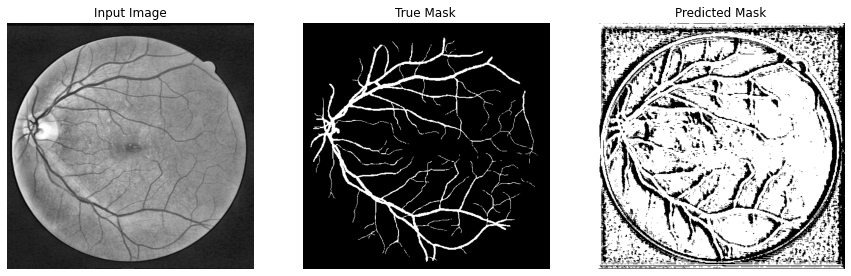


Sample Prediction after epoch 6


Epoch 00006: val_accuracy did not improve from 0.85355

Epoch 00006: ReduceLROnPlateau reducing learning rate to 0.00018000000854954124.
Epoch 7/400
2/2 [==============================] - 1s 601ms/step - loss: 0.3092 - accuracy: 0.9367 - val_loss: 1.1039 - val_accuracy: 0.4514

Epoch 00007: val_accuracy did not improve from 0.85355
Epoch 8/400
2/2 [==============================] - 1s 606ms/step - loss: 0.2990 - accuracy: 0.9415 - val_loss: 0.9222 - val_accuracy: 0.5154

Epoch 00008: val_accuracy did not improve from 0.85355
Epoch 9/400
2/2 [==============================] - 1s 594ms/step - loss: 0.2890 - accuracy: 0.9455 - val_loss: 1.1025 - val_accuracy: 0.4396

Epoch 00009: val_accuracy did not improve from 0.85355
Epoch 10/400
2/2 [==============================] - 1s 597ms/step - loss: 0.2802 - accuracy: 0.9486 - val_loss: 0.8927 - val_accuracy: 0.5399

Epoch 00010: val_accuracy did not improve from 0.85355
Epoch 11/400
2/2 [=====================

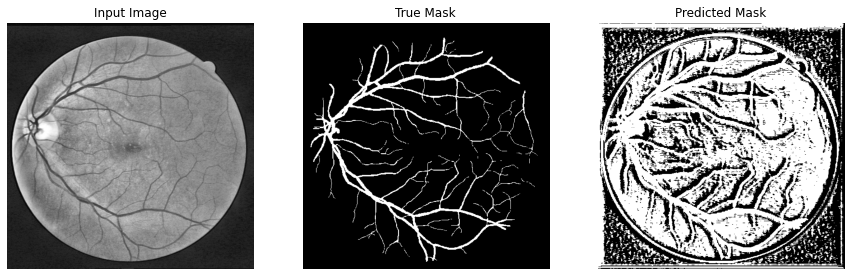


Sample Prediction after epoch 11


Epoch 00011: val_accuracy did not improve from 0.85355

Epoch 00011: ReduceLROnPlateau reducing learning rate to 0.00010800000163726508.
Epoch 12/400
2/2 [==============================] - 2s 799ms/step - loss: 0.2638 - accuracy: 0.9535 - val_loss: 0.9902 - val_accuracy: 0.4741

Epoch 00012: val_accuracy did not improve from 0.85355
Epoch 13/400
2/2 [==============================] - 1s 583ms/step - loss: 0.2592 - accuracy: 0.9546 - val_loss: 0.8722 - val_accuracy: 0.5298

Epoch 00013: val_accuracy did not improve from 0.85355
Epoch 14/400
2/2 [==============================] - 1s 589ms/step - loss: 0.2547 - accuracy: 0.9555 - val_loss: 0.7854 - val_accuracy: 0.5670

Epoch 00014: val_accuracy did not improve from 0.85355
Epoch 15/400
2/2 [==============================] - 1s 581ms/step - loss: 0.2508 - accuracy: 0.9566 - val_loss: 0.7332 - val_accuracy: 0.6043

Epoch 00015: val_accuracy did not improve from 0.85355
Epoch 16/400
2/2 [=================

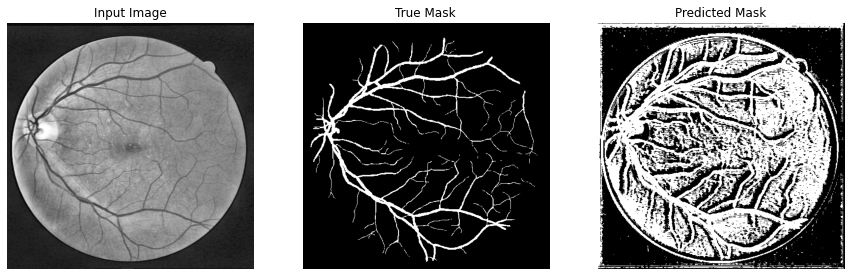


Sample Prediction after epoch 16


Epoch 00016: val_accuracy did not improve from 0.85355

Epoch 00016: ReduceLROnPlateau reducing learning rate to 6.480000010924413e-05.
Epoch 17/400
2/2 [==============================] - 1s 593ms/step - loss: 0.2430 - accuracy: 0.9579 - val_loss: 0.7326 - val_accuracy: 0.5944

Epoch 00017: val_accuracy did not improve from 0.85355
Epoch 18/400
2/2 [==============================] - 1s 582ms/step - loss: 0.2406 - accuracy: 0.9585 - val_loss: 0.6653 - val_accuracy: 0.6484

Epoch 00018: val_accuracy did not improve from 0.85355
Epoch 19/400
2/2 [==============================] - 2s 963ms/step - loss: 0.2384 - accuracy: 0.9589 - val_loss: 0.6688 - val_accuracy: 0.6293

Epoch 00019: val_accuracy did not improve from 0.85355
Epoch 20/400
2/2 [==============================] - 1s 578ms/step - loss: 0.2363 - accuracy: 0.9595 - val_loss: 0.6306 - val_accuracy: 0.6761

Epoch 00020: val_accuracy did not improve from 0.85355
Epoch 21/400
2/2 [==================

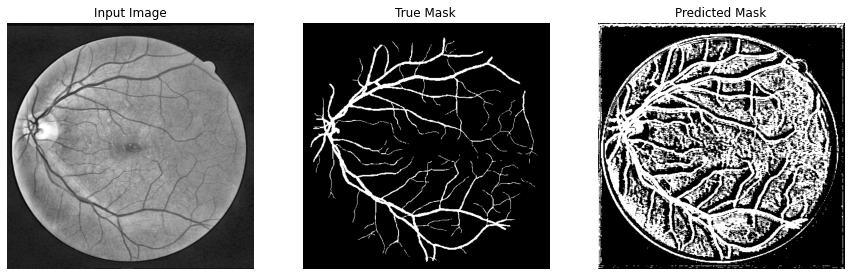


Sample Prediction after epoch 21


Epoch 00021: val_accuracy did not improve from 0.85355

Epoch 00021: ReduceLROnPlateau reducing learning rate to 3.8879999192431565e-05.
Epoch 22/400
2/2 [==============================] - 1s 570ms/step - loss: 0.2320 - accuracy: 0.9599 - val_loss: 0.6365 - val_accuracy: 0.6554

Epoch 00022: val_accuracy did not improve from 0.85355
Epoch 23/400
2/2 [==============================] - 1s 584ms/step - loss: 0.2307 - accuracy: 0.9604 - val_loss: 0.6068 - val_accuracy: 0.6892

Epoch 00023: val_accuracy did not improve from 0.85355
Epoch 24/400
2/2 [==============================] - 1s 593ms/step - loss: 0.2294 - accuracy: 0.9606 - val_loss: 0.5776 - val_accuracy: 0.7345

Epoch 00024: val_accuracy did not improve from 0.85355
Epoch 25/400
2/2 [==============================] - 1s 598ms/step - loss: 0.2281 - accuracy: 0.9608 - val_loss: 0.5675 - val_accuracy: 0.7479

Epoch 00025: val_accuracy did not improve from 0.85355
Epoch 26/400
2/2 [=================

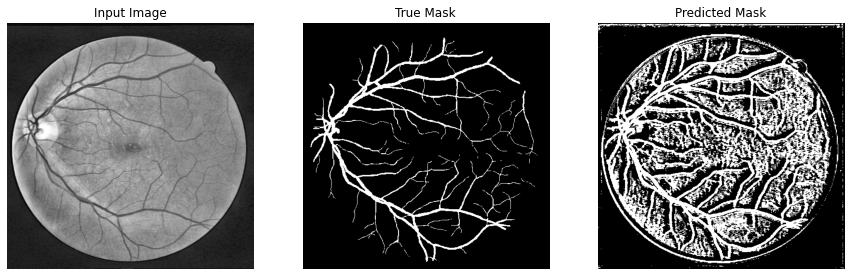


Sample Prediction after epoch 26


Epoch 00026: val_accuracy did not improve from 0.85355

Epoch 00026: ReduceLROnPlateau reducing learning rate to 2.3327999952016398e-05.
Epoch 27/400
2/2 [==============================] - 1s 596ms/step - loss: 0.2256 - accuracy: 0.9612 - val_loss: 0.5673 - val_accuracy: 0.7374

Epoch 00027: val_accuracy did not improve from 0.85355
Epoch 28/400
2/2 [==============================] - 1s 596ms/step - loss: 0.2248 - accuracy: 0.9615 - val_loss: 0.5522 - val_accuracy: 0.7603

Epoch 00028: val_accuracy did not improve from 0.85355
Epoch 29/400
2/2 [==============================] - 1s 587ms/step - loss: 0.2240 - accuracy: 0.9617 - val_loss: 0.5443 - val_accuracy: 0.7685

Epoch 00029: val_accuracy did not improve from 0.85355
Epoch 30/400
2/2 [==============================] - 1s 628ms/step - loss: 0.2232 - accuracy: 0.9619 - val_loss: 0.5400 - val_accuracy: 0.7712

Epoch 00030: val_accuracy did not improve from 0.85355
Epoch 31/400
2/2 [=================

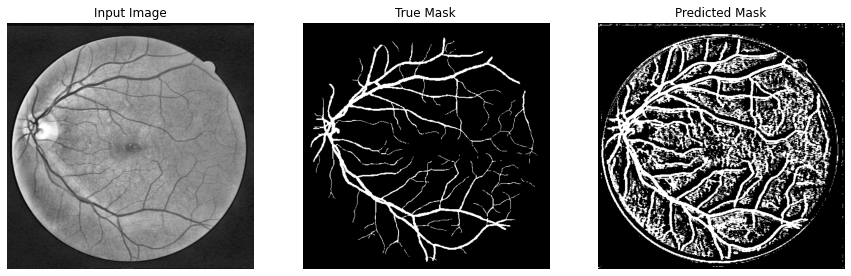


Sample Prediction after epoch 31


Epoch 00031: val_accuracy did not improve from 0.85355

Epoch 00031: ReduceLROnPlateau reducing learning rate to 1.3996800407767295e-05.
Epoch 32/400
2/2 [==============================] - 1s 594ms/step - loss: 0.2217 - accuracy: 0.9621 - val_loss: 0.5221 - val_accuracy: 0.7946

Epoch 00032: val_accuracy did not improve from 0.85355
Epoch 33/400
2/2 [==============================] - 1s 595ms/step - loss: 0.2212 - accuracy: 0.9622 - val_loss: 0.5140 - val_accuracy: 0.8062

Epoch 00033: val_accuracy did not improve from 0.85355
Epoch 34/400
2/2 [==============================] - 1s 596ms/step - loss: 0.2207 - accuracy: 0.9623 - val_loss: 0.5070 - val_accuracy: 0.8158

Epoch 00034: val_accuracy did not improve from 0.85355
Epoch 35/400
2/2 [==============================] - 1s 580ms/step - loss: 0.2203 - accuracy: 0.9624 - val_loss: 0.5006 - val_accuracy: 0.8238

Epoch 00035: val_accuracy did not improve from 0.85355
Epoch 36/400
2/2 [=================

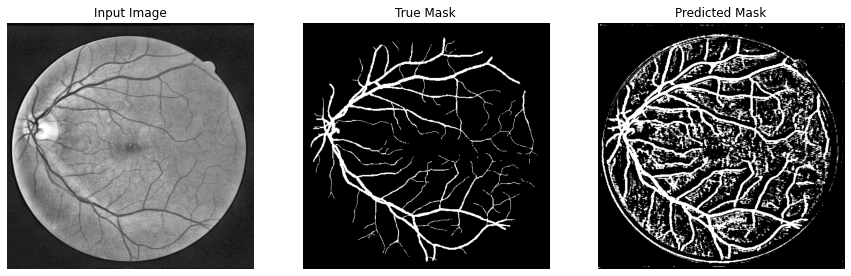


Sample Prediction after epoch 36


Epoch 00036: val_accuracy did not improve from 0.85355

Epoch 00036: ReduceLROnPlateau reducing learning rate to 8.398080353799742e-06.
Epoch 37/400
2/2 [==============================] - 1s 590ms/step - loss: 0.2193 - accuracy: 0.9626 - val_loss: 0.4868 - val_accuracy: 0.8416

Epoch 00037: val_accuracy did not improve from 0.85355
Epoch 38/400
2/2 [==============================] - 1s 610ms/step - loss: 0.2190 - accuracy: 0.9627 - val_loss: 0.4799 - val_accuracy: 0.8505

Epoch 00038: val_accuracy did not improve from 0.85355
Epoch 39/400
2/2 [==============================] - 1s 582ms/step - loss: 0.2187 - accuracy: 0.9627 - val_loss: 0.4726 - val_accuracy: 0.8590

Epoch 00039: val_accuracy improved from 0.85355 to 0.85901, saving model to ./unet_backbone_vgg19.h5
Epoch 40/400
2/2 [==============================] - 1s 609ms/step - loss: 0.2185 - accuracy: 0.9628 - val_loss: 0.4653 - val_accuracy: 0.8672

Epoch 00040: val_accuracy improved from 0.859

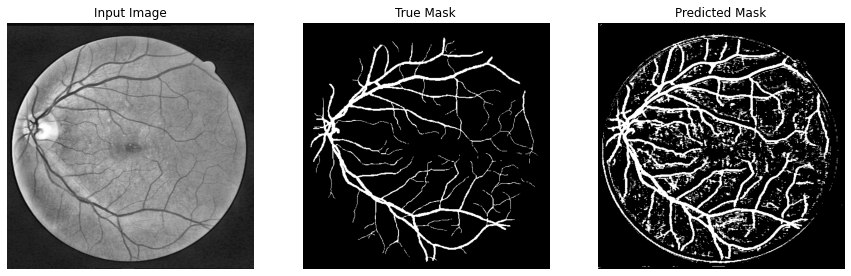


Sample Prediction after epoch 41


Epoch 00041: val_accuracy improved from 0.86715 to 0.87489, saving model to ./unet_backbone_vgg19.h5
Epoch 42/400
2/2 [==============================] - 1s 594ms/step - loss: 0.2179 - accuracy: 0.9629 - val_loss: 0.4505 - val_accuracy: 0.8822

Epoch 00042: val_accuracy improved from 0.87489 to 0.88218, saving model to ./unet_backbone_vgg19.h5
Epoch 43/400
2/2 [==============================] - 1s 597ms/step - loss: 0.2176 - accuracy: 0.9630 - val_loss: 0.4433 - val_accuracy: 0.8887

Epoch 00043: val_accuracy improved from 0.88218 to 0.88874, saving model to ./unet_backbone_vgg19.h5
Epoch 44/400
2/2 [==============================] - 1s 584ms/step - loss: 0.2173 - accuracy: 0.9630 - val_loss: 0.4362 - val_accuracy: 0.8949

Epoch 00044: val_accuracy improved from 0.88874 to 0.89489, saving model to ./unet_backbone_vgg19.h5
Epoch 45/400
2/2 [==============================] - 1s 582ms/step - loss: 0.2170 - accuracy: 0.9631 - val_loss: 0.4291 - val_accura

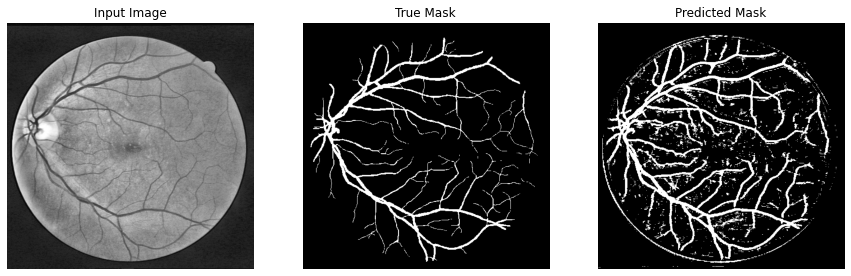


Sample Prediction after epoch 46


Epoch 00046: val_accuracy improved from 0.90062 to 0.90557, saving model to ./unet_backbone_vgg19.h5
Epoch 47/400
2/2 [==============================] - 1s 596ms/step - loss: 0.2164 - accuracy: 0.9632 - val_loss: 0.4145 - val_accuracy: 0.9107

Epoch 00047: val_accuracy improved from 0.90557 to 0.91074, saving model to ./unet_backbone_vgg19.h5
Epoch 48/400
2/2 [==============================] - 2s 752ms/step - loss: 0.2161 - accuracy: 0.9633 - val_loss: 0.4075 - val_accuracy: 0.9148

Epoch 00048: val_accuracy improved from 0.91074 to 0.91478, saving model to ./unet_backbone_vgg19.h5
Epoch 49/400
2/2 [==============================] - 1s 586ms/step - loss: 0.2158 - accuracy: 0.9633 - val_loss: 0.3996 - val_accuracy: 0.9192

Epoch 00049: val_accuracy improved from 0.91478 to 0.91925, saving model to ./unet_backbone_vgg19.h5
Epoch 50/400
2/2 [==============================] - 1s 583ms/step - loss: 0.2155 - accuracy: 0.9634 - val_loss: 0.3935 - val_accura

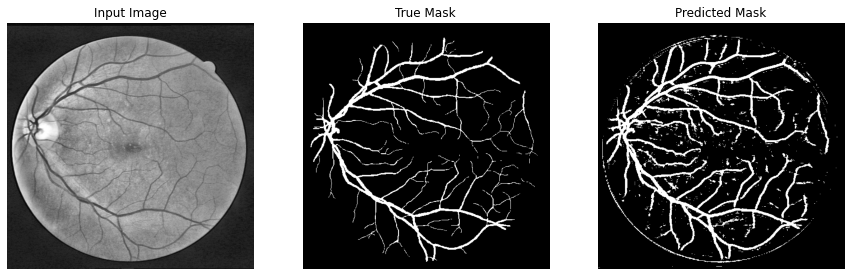


Sample Prediction after epoch 51


Epoch 00051: val_accuracy improved from 0.92210 to 0.92604, saving model to ./unet_backbone_vgg19.h5
Epoch 52/400
2/2 [==============================] - 1s 583ms/step - loss: 0.2149 - accuracy: 0.9636 - val_loss: 0.3798 - val_accuracy: 0.9281

Epoch 00052: val_accuracy improved from 0.92604 to 0.92813, saving model to ./unet_backbone_vgg19.h5
Epoch 53/400
2/2 [==============================] - 1s 618ms/step - loss: 0.2146 - accuracy: 0.9636 - val_loss: 0.3717 - val_accuracy: 0.9315

Epoch 00053: val_accuracy improved from 0.92813 to 0.93150, saving model to ./unet_backbone_vgg19.h5
Epoch 54/400
2/2 [==============================] - 1s 580ms/step - loss: 0.2143 - accuracy: 0.9637 - val_loss: 0.3667 - val_accuracy: 0.9331

Epoch 00054: val_accuracy improved from 0.93150 to 0.93308, saving model to ./unet_backbone_vgg19.h5
Epoch 55/400
2/2 [==============================] - 1s 589ms/step - loss: 0.2140 - accuracy: 0.9637 - val_loss: 0.3599 - val_accura

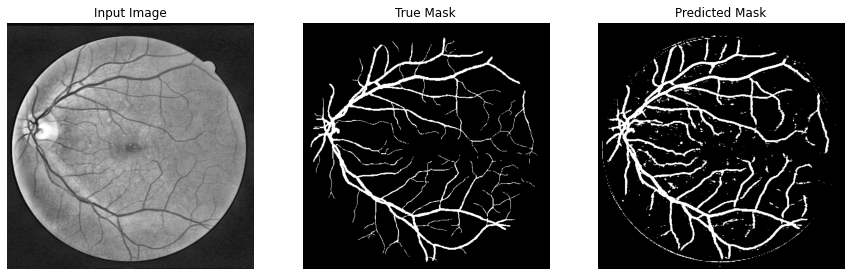


Sample Prediction after epoch 56


Epoch 00056: val_accuracy improved from 0.93551 to 0.93739, saving model to ./unet_backbone_vgg19.h5
Epoch 57/400
2/2 [==============================] - 2s 716ms/step - loss: 0.2134 - accuracy: 0.9639 - val_loss: 0.3498 - val_accuracy: 0.9385

Epoch 00057: val_accuracy improved from 0.93739 to 0.93851, saving model to ./unet_backbone_vgg19.h5
Epoch 58/400
2/2 [==============================] - 1s 585ms/step - loss: 0.2131 - accuracy: 0.9639 - val_loss: 0.3428 - val_accuracy: 0.9407

Epoch 00058: val_accuracy improved from 0.93851 to 0.94068, saving model to ./unet_backbone_vgg19.h5
Epoch 59/400
2/2 [==============================] - 1s 586ms/step - loss: 0.2128 - accuracy: 0.9640 - val_loss: 0.3389 - val_accuracy: 0.9417

Epoch 00059: val_accuracy improved from 0.94068 to 0.94168, saving model to ./unet_backbone_vgg19.h5
Epoch 60/400
2/2 [==============================] - 1s 583ms/step - loss: 0.2125 - accuracy: 0.9640 - val_loss: 0.3339 - val_accura

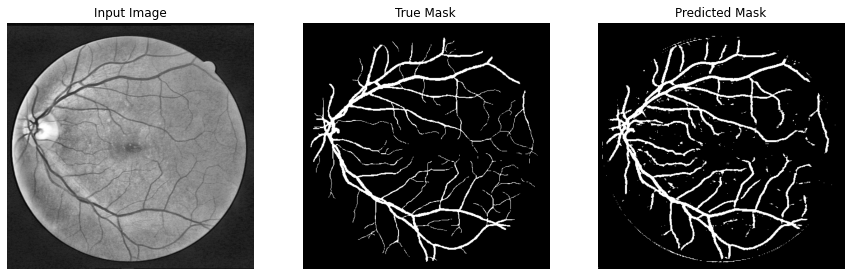


Sample Prediction after epoch 61


Epoch 00061: val_accuracy improved from 0.94298 to 0.94446, saving model to ./unet_backbone_vgg19.h5
Epoch 62/400
2/2 [==============================] - 2s 715ms/step - loss: 0.2119 - accuracy: 0.9642 - val_loss: 0.3255 - val_accuracy: 0.9451

Epoch 00062: val_accuracy improved from 0.94446 to 0.94515, saving model to ./unet_backbone_vgg19.h5
Epoch 63/400
2/2 [==============================] - 1s 588ms/step - loss: 0.2116 - accuracy: 0.9642 - val_loss: 0.3200 - val_accuracy: 0.9466

Epoch 00063: val_accuracy improved from 0.94515 to 0.94660, saving model to ./unet_backbone_vgg19.h5
Epoch 64/400
2/2 [==============================] - 1s 596ms/step - loss: 0.2113 - accuracy: 0.9643 - val_loss: 0.3169 - val_accuracy: 0.9473

Epoch 00064: val_accuracy improved from 0.94660 to 0.94735, saving model to ./unet_backbone_vgg19.h5
Epoch 65/400
2/2 [==============================] - 1s 582ms/step - loss: 0.2110 - accuracy: 0.9644 - val_loss: 0.3128 - val_accura

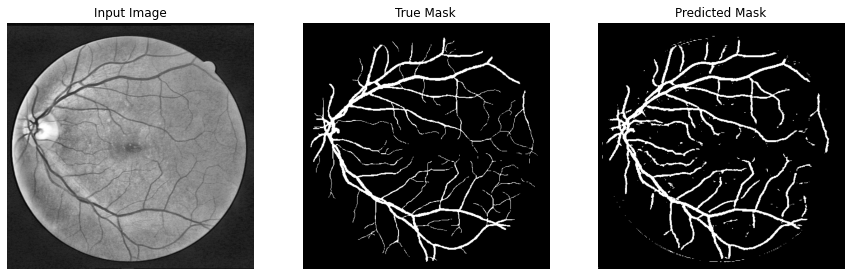


Sample Prediction after epoch 66


Epoch 00066: val_accuracy improved from 0.94832 to 0.94909, saving model to ./unet_backbone_vgg19.h5
Epoch 67/400
2/2 [==============================] - 1s 577ms/step - loss: 0.2104 - accuracy: 0.9645 - val_loss: 0.3060 - val_accuracy: 0.9497

Epoch 00067: val_accuracy improved from 0.94909 to 0.94969, saving model to ./unet_backbone_vgg19.h5
Epoch 68/400
2/2 [==============================] - 2s 957ms/step - loss: 0.2101 - accuracy: 0.9645 - val_loss: 0.3029 - val_accuracy: 0.9504

Epoch 00068: val_accuracy improved from 0.94969 to 0.95044, saving model to ./unet_backbone_vgg19.h5
Epoch 69/400
2/2 [==============================] - 1s 585ms/step - loss: 0.2098 - accuracy: 0.9646 - val_loss: 0.2997 - val_accuracy: 0.9510

Epoch 00069: val_accuracy improved from 0.95044 to 0.95096, saving model to ./unet_backbone_vgg19.h5
Epoch 70/400
2/2 [==============================] - 1s 587ms/step - loss: 0.2095 - accuracy: 0.9646 - val_loss: 0.2968 - val_accura

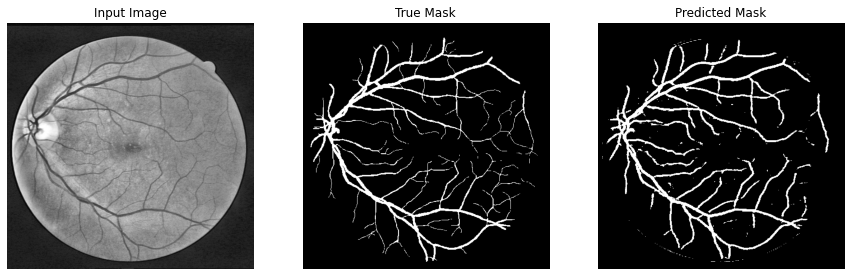


Sample Prediction after epoch 71


Epoch 00071: val_accuracy improved from 0.95159 to 0.95210, saving model to ./unet_backbone_vgg19.h5
Epoch 72/400
2/2 [==============================] - 1s 621ms/step - loss: 0.2089 - accuracy: 0.9647 - val_loss: 0.2913 - val_accuracy: 0.9527

Epoch 00072: val_accuracy improved from 0.95210 to 0.95266, saving model to ./unet_backbone_vgg19.h5
Epoch 73/400
2/2 [==============================] - 2s 572ms/step - loss: 0.2086 - accuracy: 0.9649 - val_loss: 0.2884 - val_accuracy: 0.9532

Epoch 00073: val_accuracy improved from 0.95266 to 0.95316, saving model to ./unet_backbone_vgg19.h5
Epoch 74/400
2/2 [==============================] - 1s 591ms/step - loss: 0.2083 - accuracy: 0.9648 - val_loss: 0.2863 - val_accuracy: 0.9535

Epoch 00074: val_accuracy improved from 0.95316 to 0.95352, saving model to ./unet_backbone_vgg19.h5
Epoch 75/400
2/2 [==============================] - 1s 577ms/step - loss: 0.2080 - accuracy: 0.9650 - val_loss: 0.2832 - val_accura

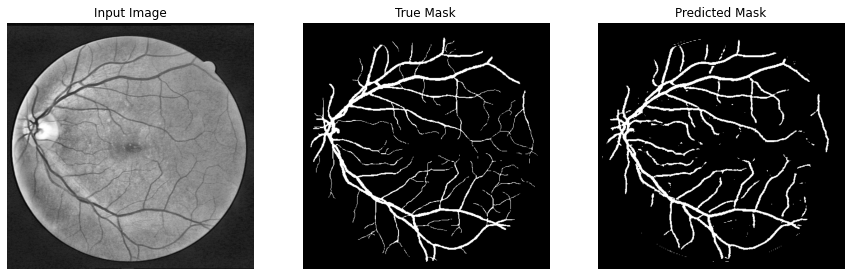


Sample Prediction after epoch 76


Epoch 00076: val_accuracy improved from 0.95401 to 0.95416, saving model to ./unet_backbone_vgg19.h5
Epoch 77/400
2/2 [==============================] - 1s 583ms/step - loss: 0.2075 - accuracy: 0.9650 - val_loss: 0.2783 - val_accuracy: 0.9548

Epoch 00077: val_accuracy improved from 0.95416 to 0.95478, saving model to ./unet_backbone_vgg19.h5
Epoch 78/400
2/2 [==============================] - 2s 772ms/step - loss: 0.2072 - accuracy: 0.9651 - val_loss: 0.2777 - val_accuracy: 0.9548

Epoch 00078: val_accuracy improved from 0.95478 to 0.95478, saving model to ./unet_backbone_vgg19.h5
Epoch 79/400
2/2 [==============================] - 1s 577ms/step - loss: 0.2069 - accuracy: 0.9650 - val_loss: 0.2739 - val_accuracy: 0.9555

Epoch 00079: val_accuracy improved from 0.95478 to 0.95547, saving model to ./unet_backbone_vgg19.h5
Epoch 80/400
2/2 [==============================] - 1s 571ms/step - loss: 0.2067 - accuracy: 0.9652 - val_loss: 0.2732 - val_accura

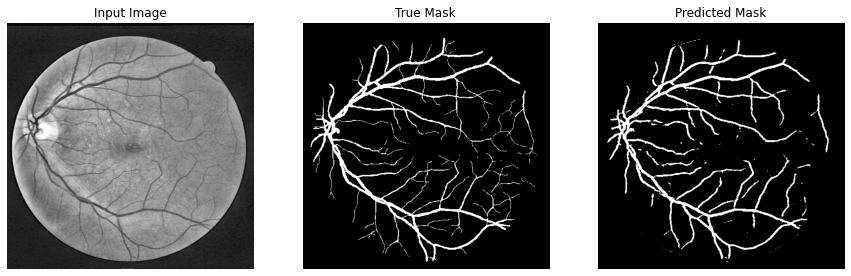


Sample Prediction after epoch 81


Epoch 00081: val_accuracy improved from 0.95547 to 0.95581, saving model to ./unet_backbone_vgg19.h5
Epoch 82/400
2/2 [==============================] - 1s 589ms/step - loss: 0.2061 - accuracy: 0.9653 - val_loss: 0.2678 - val_accuracy: 0.9562

Epoch 00082: val_accuracy improved from 0.95581 to 0.95618, saving model to ./unet_backbone_vgg19.h5
Epoch 83/400
2/2 [==============================] - 1s 585ms/step - loss: 0.2058 - accuracy: 0.9653 - val_loss: 0.2679 - val_accuracy: 0.9561

Epoch 00083: val_accuracy did not improve from 0.95618
Epoch 84/400
2/2 [==============================] - 1s 609ms/step - loss: 0.2055 - accuracy: 0.9654 - val_loss: 0.2645 - val_accuracy: 0.9567

Epoch 00084: val_accuracy improved from 0.95618 to 0.95666, saving model to ./unet_backbone_vgg19.h5
Epoch 85/400
2/2 [==============================] - 1s 593ms/step - loss: 0.2052 - accuracy: 0.9655 - val_loss: 0.2629 - val_accuracy: 0.9568

Epoch 00085: val_accuracy improved

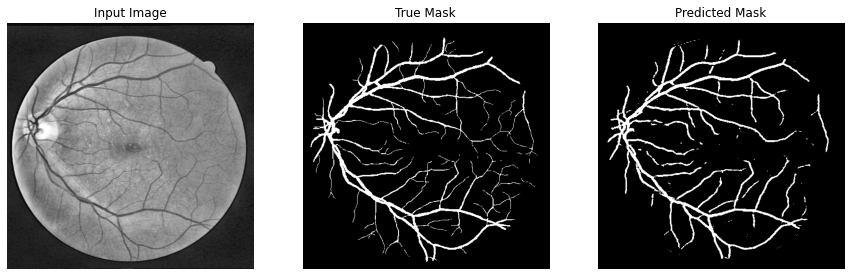


Sample Prediction after epoch 86


Epoch 00086: val_accuracy improved from 0.95680 to 0.95681, saving model to ./unet_backbone_vgg19.h5
Epoch 87/400
2/2 [==============================] - 1s 611ms/step - loss: 0.2047 - accuracy: 0.9655 - val_loss: 0.2593 - val_accuracy: 0.9573

Epoch 00087: val_accuracy improved from 0.95681 to 0.95730, saving model to ./unet_backbone_vgg19.h5
Epoch 88/400
2/2 [==============================] - 1s 608ms/step - loss: 0.2044 - accuracy: 0.9656 - val_loss: 0.2581 - val_accuracy: 0.9572

Epoch 00088: val_accuracy did not improve from 0.95730
Epoch 89/400
2/2 [==============================] - 1s 626ms/step - loss: 0.2042 - accuracy: 0.9656 - val_loss: 0.2566 - val_accuracy: 0.9574

Epoch 00089: val_accuracy improved from 0.95730 to 0.95744, saving model to ./unet_backbone_vgg19.h5
Epoch 90/400
2/2 [==============================] - 2s 591ms/step - loss: 0.2039 - accuracy: 0.9656 - val_loss: 0.2549 - val_accuracy: 0.9576

Epoch 00090: val_accuracy improved

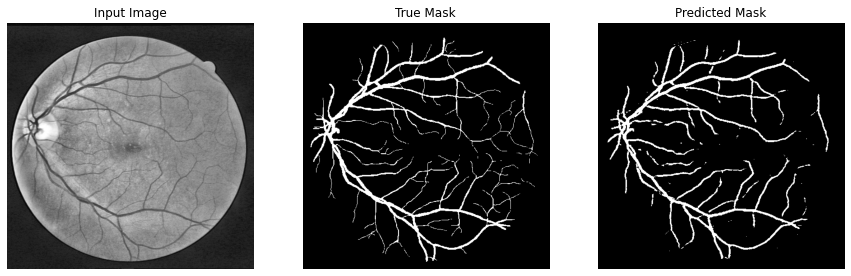


Sample Prediction after epoch 91


Epoch 00091: val_accuracy improved from 0.95758 to 0.95769, saving model to ./unet_backbone_vgg19.h5
Epoch 92/400
2/2 [==============================] - 1s 594ms/step - loss: 0.2033 - accuracy: 0.9658 - val_loss: 0.2525 - val_accuracy: 0.9577

Epoch 00092: val_accuracy improved from 0.95769 to 0.95771, saving model to ./unet_backbone_vgg19.h5
Epoch 93/400
2/2 [==============================] - 1s 589ms/step - loss: 0.2030 - accuracy: 0.9659 - val_loss: 0.2501 - val_accuracy: 0.9579

Epoch 00093: val_accuracy improved from 0.95771 to 0.95795, saving model to ./unet_backbone_vgg19.h5
Epoch 94/400
2/2 [==============================] - 1s 583ms/step - loss: 0.2027 - accuracy: 0.9659 - val_loss: 0.2493 - val_accuracy: 0.9580

Epoch 00094: val_accuracy improved from 0.95795 to 0.95801, saving model to ./unet_backbone_vgg19.h5
Epoch 95/400
2/2 [==============================] - 1s 606ms/step - loss: 0.2024 - accuracy: 0.9660 - val_loss: 0.2477 - val_accura

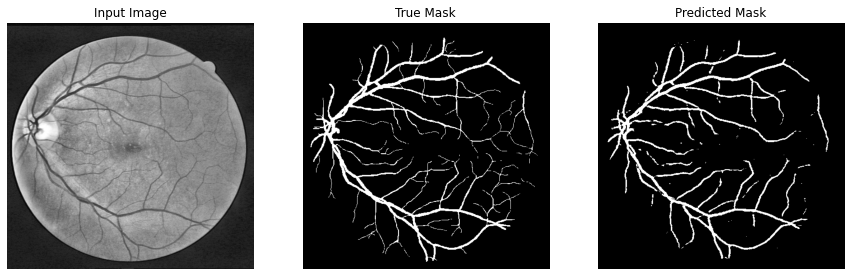


Sample Prediction after epoch 96


Epoch 00096: val_accuracy improved from 0.95802 to 0.95824, saving model to ./unet_backbone_vgg19.h5
Epoch 97/400
2/2 [==============================] - 1s 589ms/step - loss: 0.2019 - accuracy: 0.9661 - val_loss: 0.2450 - val_accuracy: 0.9582

Epoch 00097: val_accuracy did not improve from 0.95824
Epoch 98/400
2/2 [==============================] - 1s 582ms/step - loss: 0.2016 - accuracy: 0.9661 - val_loss: 0.2435 - val_accuracy: 0.9584

Epoch 00098: val_accuracy improved from 0.95824 to 0.95839, saving model to ./unet_backbone_vgg19.h5
Epoch 99/400
2/2 [==============================] - 2s 773ms/step - loss: 0.2013 - accuracy: 0.9662 - val_loss: 0.2425 - val_accuracy: 0.9584

Epoch 00099: val_accuracy improved from 0.95839 to 0.95841, saving model to ./unet_backbone_vgg19.h5
Epoch 100/400
2/2 [==============================] - 2s 791ms/step - loss: 0.2011 - accuracy: 0.9663 - val_loss: 0.2411 - val_accuracy: 0.9585

Epoch 00100: val_accuracy improve

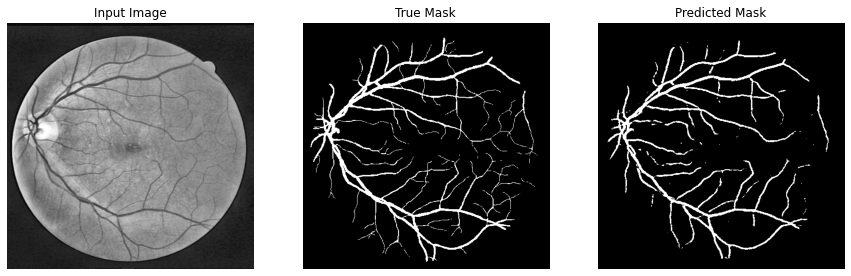


Sample Prediction after epoch 101


Epoch 00101: val_accuracy did not improve from 0.95846
Epoch 102/400
2/2 [==============================] - 1s 600ms/step - loss: 0.2005 - accuracy: 0.9664 - val_loss: 0.2387 - val_accuracy: 0.9585

Epoch 00102: val_accuracy did not improve from 0.95846
Epoch 103/400
2/2 [==============================] - 1s 582ms/step - loss: 0.2002 - accuracy: 0.9664 - val_loss: 0.2379 - val_accuracy: 0.9585

Epoch 00103: val_accuracy improved from 0.95846 to 0.95850, saving model to ./unet_backbone_vgg19.h5
Epoch 104/400
2/2 [==============================] - 1s 621ms/step - loss: 0.2000 - accuracy: 0.9665 - val_loss: 0.2365 - val_accuracy: 0.9585

Epoch 00104: val_accuracy did not improve from 0.95850
Epoch 105/400
2/2 [==============================] - 1s 598ms/step - loss: 0.1997 - accuracy: 0.9665 - val_loss: 0.2356 - val_accuracy: 0.9585

Epoch 00105: val_accuracy improved from 0.95850 to 0.95852, saving model to ./unet_backbone_vgg19.h5
Epoch 106/400
2/2 [=

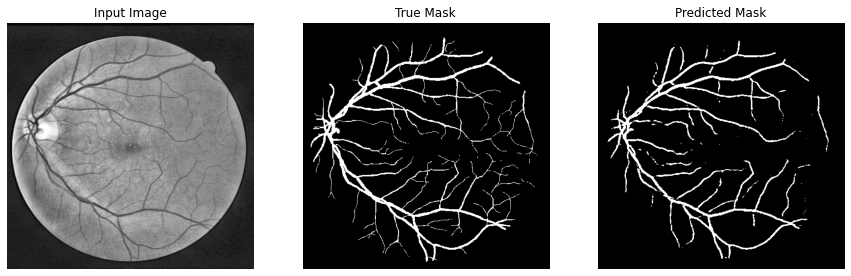


Sample Prediction after epoch 106


Epoch 00106: val_accuracy improved from 0.95852 to 0.95860, saving model to ./unet_backbone_vgg19.h5
Epoch 107/400
2/2 [==============================] - 2s 624ms/step - loss: 0.1992 - accuracy: 0.9666 - val_loss: 0.2335 - val_accuracy: 0.9585

Epoch 00107: val_accuracy did not improve from 0.95860
Epoch 108/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1990 - accuracy: 0.9666 - val_loss: 0.2327 - val_accuracy: 0.9586

Epoch 00108: val_accuracy did not improve from 0.95860
Epoch 109/400
2/2 [==============================] - 1s 617ms/step - loss: 0.1987 - accuracy: 0.9667 - val_loss: 0.2314 - val_accuracy: 0.9585

Epoch 00109: val_accuracy did not improve from 0.95860
Epoch 110/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1984 - accuracy: 0.9667 - val_loss: 0.2310 - val_accuracy: 0.9586

Epoch 00110: val_accuracy did not improve from 0.95860
Epoch 111/400
2/2 [==============================] - 1s 600ms/step

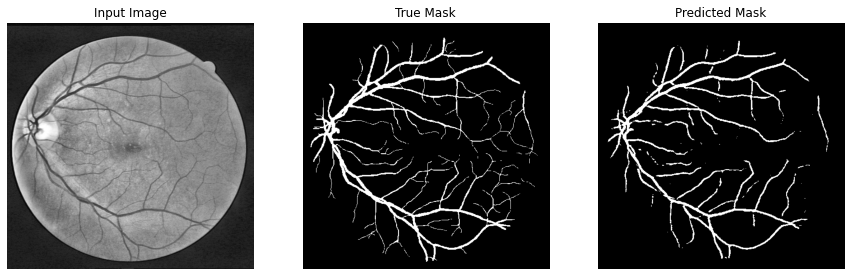


Sample Prediction after epoch 111


Epoch 00111: val_accuracy did not improve from 0.95860

Epoch 00111: ReduceLROnPlateau reducing learning rate to 5.038848212279845e-06.
Epoch 112/400
2/2 [==============================] - 1s 593ms/step - loss: 0.1979 - accuracy: 0.9668 - val_loss: 0.2291 - val_accuracy: 0.9585

Epoch 00112: val_accuracy did not improve from 0.95860
Epoch 113/400
2/2 [==============================] - 2s 807ms/step - loss: 0.1977 - accuracy: 0.9669 - val_loss: 0.2286 - val_accuracy: 0.9585

Epoch 00113: val_accuracy did not improve from 0.95860
Epoch 114/400
2/2 [==============================] - 2s 590ms/step - loss: 0.1976 - accuracy: 0.9669 - val_loss: 0.2278 - val_accuracy: 0.9585

Epoch 00114: val_accuracy did not improve from 0.95860
Epoch 115/400
2/2 [==============================] - 1s 599ms/step - loss: 0.1974 - accuracy: 0.9670 - val_loss: 0.2269 - val_accuracy: 0.9585

Epoch 00115: val_accuracy did not improve from 0.95860
Epoch 116/400
2/2 [============

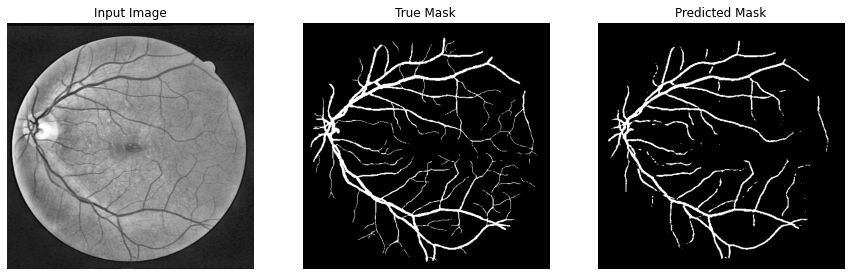


Sample Prediction after epoch 116


Epoch 00116: val_accuracy did not improve from 0.95860

Epoch 00116: ReduceLROnPlateau reducing learning rate to 3.0233088182285426e-06.
Epoch 117/400
2/2 [==============================] - 1s 608ms/step - loss: 0.1971 - accuracy: 0.9671 - val_loss: 0.2260 - val_accuracy: 0.9585

Epoch 00117: val_accuracy did not improve from 0.95860
Epoch 118/400
2/2 [==============================] - 1s 607ms/step - loss: 0.1970 - accuracy: 0.9671 - val_loss: 0.2253 - val_accuracy: 0.9584

Epoch 00118: val_accuracy did not improve from 0.95860
Epoch 119/400
2/2 [==============================] - 2s 768ms/step - loss: 0.1969 - accuracy: 0.9671 - val_loss: 0.2247 - val_accuracy: 0.9585

Epoch 00119: val_accuracy did not improve from 0.95860
Epoch 120/400
2/2 [==============================] - 1s 593ms/step - loss: 0.1968 - accuracy: 0.9671 - val_loss: 0.2243 - val_accuracy: 0.9584

Epoch 00120: val_accuracy did not improve from 0.95860
Epoch 121/400
2/2 [===========

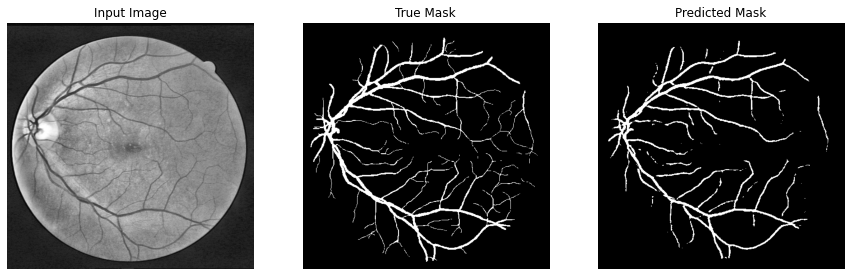


Sample Prediction after epoch 121


Epoch 00121: val_accuracy did not improve from 0.95860

Epoch 00121: ReduceLROnPlateau reducing learning rate to 1.8139853182219667e-06.
Epoch 122/400
2/2 [==============================] - 1s 601ms/step - loss: 0.1966 - accuracy: 0.9672 - val_loss: 0.2233 - val_accuracy: 0.9584

Epoch 00122: val_accuracy did not improve from 0.95860
Epoch 123/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1965 - accuracy: 0.9672 - val_loss: 0.2228 - val_accuracy: 0.9585

Epoch 00123: val_accuracy did not improve from 0.95860
Epoch 124/400
2/2 [==============================] - 1s 586ms/step - loss: 0.1965 - accuracy: 0.9672 - val_loss: 0.2224 - val_accuracy: 0.9585

Epoch 00124: val_accuracy did not improve from 0.95860
Epoch 125/400
2/2 [==============================] - 1s 600ms/step - loss: 0.1964 - accuracy: 0.9672 - val_loss: 0.2220 - val_accuracy: 0.9585

Epoch 00125: val_accuracy did not improve from 0.95860
Epoch 126/400
2/2 [===========

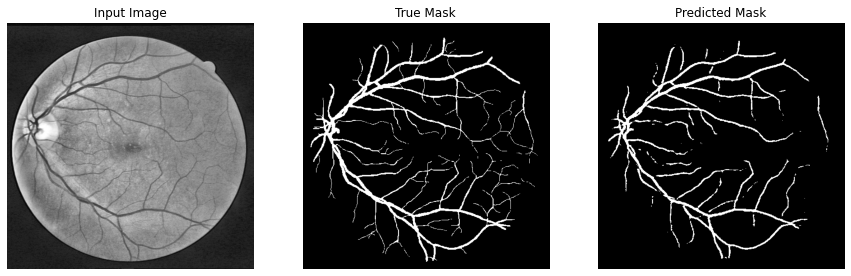


Sample Prediction after epoch 126


Epoch 00126: val_accuracy did not improve from 0.95860

Epoch 00126: ReduceLROnPlateau reducing learning rate to 1.0883912182180211e-06.
Epoch 127/400
2/2 [==============================] - 1s 592ms/step - loss: 0.1963 - accuracy: 0.9672 - val_loss: 0.2212 - val_accuracy: 0.9585

Epoch 00127: val_accuracy did not improve from 0.95860
Epoch 128/400
2/2 [==============================] - 1s 600ms/step - loss: 0.1963 - accuracy: 0.9672 - val_loss: 0.2208 - val_accuracy: 0.9586

Epoch 00128: val_accuracy did not improve from 0.95860
Epoch 129/400
2/2 [==============================] - 1s 592ms/step - loss: 0.1962 - accuracy: 0.9672 - val_loss: 0.2204 - val_accuracy: 0.9586

Epoch 00129: val_accuracy did not improve from 0.95860
Epoch 130/400
2/2 [==============================] - 1s 595ms/step - loss: 0.1962 - accuracy: 0.9672 - val_loss: 0.2201 - val_accuracy: 0.9586

Epoch 00130: val_accuracy did not improve from 0.95860
Epoch 131/400
2/2 [===========

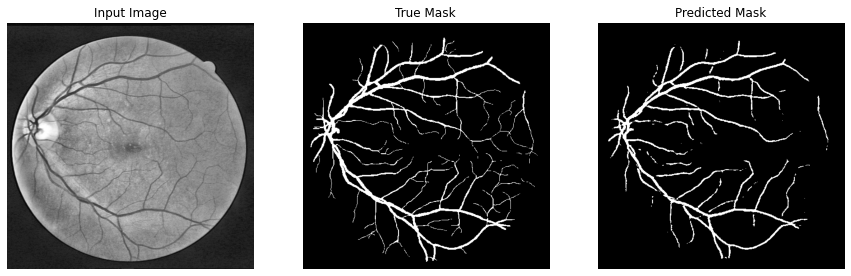


Sample Prediction after epoch 131


Epoch 00131: val_accuracy improved from 0.95860 to 0.95860, saving model to ./unet_backbone_vgg19.h5

Epoch 00131: ReduceLROnPlateau reducing learning rate to 6.530347036459716e-07.
Epoch 132/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1961 - accuracy: 0.9672 - val_loss: 0.2194 - val_accuracy: 0.9586

Epoch 00132: val_accuracy improved from 0.95860 to 0.95863, saving model to ./unet_backbone_vgg19.h5
Epoch 133/400
2/2 [==============================] - 2s 787ms/step - loss: 0.1961 - accuracy: 0.9672 - val_loss: 0.2191 - val_accuracy: 0.9586

Epoch 00133: val_accuracy improved from 0.95863 to 0.95864, saving model to ./unet_backbone_vgg19.h5
Epoch 134/400
2/2 [==============================] - 1s 599ms/step - loss: 0.1961 - accuracy: 0.9673 - val_loss: 0.2188 - val_accuracy: 0.9586

Epoch 00134: val_accuracy improved from 0.95864 to 0.95865, saving model to ./unet_backbone_vgg19.h5
Epoch 135/400
2/2 [===========================

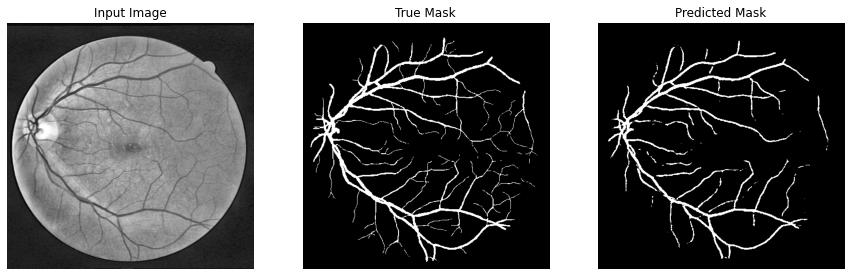


Sample Prediction after epoch 136


Epoch 00136: val_accuracy improved from 0.95865 to 0.95867, saving model to ./unet_backbone_vgg19.h5

Epoch 00136: ReduceLROnPlateau reducing learning rate to 3.9182082218758295e-07.
Epoch 137/400
2/2 [==============================] - 1s 601ms/step - loss: 0.1960 - accuracy: 0.9673 - val_loss: 0.2179 - val_accuracy: 0.9587

Epoch 00137: val_accuracy improved from 0.95867 to 0.95868, saving model to ./unet_backbone_vgg19.h5
Epoch 138/400
2/2 [==============================] - 1s 607ms/step - loss: 0.1960 - accuracy: 0.9673 - val_loss: 0.2176 - val_accuracy: 0.9587

Epoch 00138: val_accuracy improved from 0.95868 to 0.95869, saving model to ./unet_backbone_vgg19.h5
Epoch 139/400
2/2 [==============================] - 1s 598ms/step - loss: 0.1960 - accuracy: 0.9673 - val_loss: 0.2174 - val_accuracy: 0.9587

Epoch 00139: val_accuracy improved from 0.95869 to 0.95870, saving model to ./unet_backbone_vgg19.h5
Epoch 140/400
2/2 [==========================

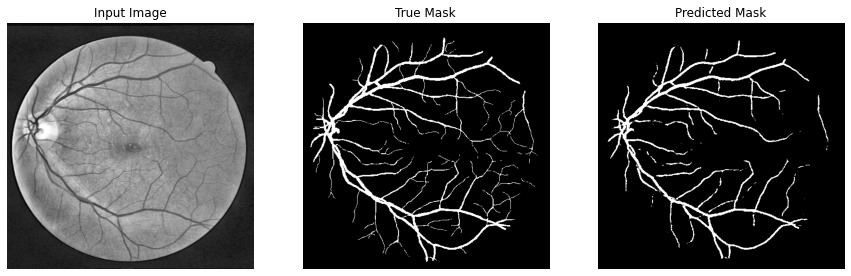


Sample Prediction after epoch 141


Epoch 00141: val_accuracy improved from 0.95872 to 0.95873, saving model to ./unet_backbone_vgg19.h5
Epoch 142/400
2/2 [==============================] - 1s 606ms/step - loss: 0.1959 - accuracy: 0.9673 - val_loss: 0.2166 - val_accuracy: 0.9587

Epoch 00142: val_accuracy improved from 0.95873 to 0.95875, saving model to ./unet_backbone_vgg19.h5
Epoch 143/400
2/2 [==============================] - 1s 599ms/step - loss: 0.1959 - accuracy: 0.9673 - val_loss: 0.2164 - val_accuracy: 0.9588

Epoch 00143: val_accuracy improved from 0.95875 to 0.95876, saving model to ./unet_backbone_vgg19.h5
Epoch 144/400
2/2 [==============================] - 1s 579ms/step - loss: 0.1959 - accuracy: 0.9673 - val_loss: 0.2161 - val_accuracy: 0.9588

Epoch 00144: val_accuracy improved from 0.95876 to 0.95880, saving model to ./unet_backbone_vgg19.h5

Epoch 00144: ReduceLROnPlateau reducing learning rate to 2.3509250013376004e-07.
Epoch 145/400
2/2 [==========================

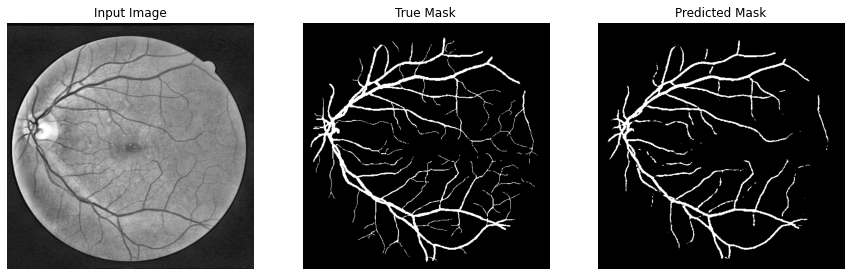


Sample Prediction after epoch 146


Epoch 00146: val_accuracy improved from 0.95880 to 0.95880, saving model to ./unet_backbone_vgg19.h5
Epoch 147/400
2/2 [==============================] - 1s 569ms/step - loss: 0.1959 - accuracy: 0.9673 - val_loss: 0.2155 - val_accuracy: 0.9588

Epoch 00147: val_accuracy improved from 0.95880 to 0.95880, saving model to ./unet_backbone_vgg19.h5
Epoch 148/400
2/2 [==============================] - 2s 763ms/step - loss: 0.1959 - accuracy: 0.9673 - val_loss: 0.2153 - val_accuracy: 0.9588

Epoch 00148: val_accuracy improved from 0.95880 to 0.95882, saving model to ./unet_backbone_vgg19.h5
Epoch 149/400
2/2 [==============================] - 1s 578ms/step - loss: 0.1959 - accuracy: 0.9673 - val_loss: 0.2151 - val_accuracy: 0.9588

Epoch 00149: val_accuracy improved from 0.95882 to 0.95883, saving model to ./unet_backbone_vgg19.h5
Epoch 150/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1959 - accuracy: 0.9673 - val_loss: 0.2149 - val_a

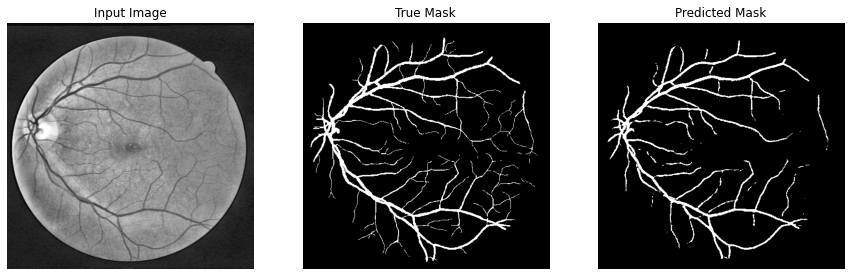


Sample Prediction after epoch 151


Epoch 00151: val_accuracy improved from 0.95884 to 0.95884, saving model to ./unet_backbone_vgg19.h5
Epoch 152/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1959 - accuracy: 0.9673 - val_loss: 0.2146 - val_accuracy: 0.9588

Epoch 00152: val_accuracy improved from 0.95884 to 0.95885, saving model to ./unet_backbone_vgg19.h5

Epoch 00152: ReduceLROnPlateau reducing learning rate to 1.4105550008025603e-07.
Epoch 153/400
2/2 [==============================] - 1s 609ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2144 - val_accuracy: 0.9589

Epoch 00153: val_accuracy improved from 0.95885 to 0.95886, saving model to ./unet_backbone_vgg19.h5
Epoch 154/400
2/2 [==============================] - 1s 598ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2142 - val_accuracy: 0.9589

Epoch 00154: val_accuracy improved from 0.95886 to 0.95887, saving model to ./unet_backbone_vgg19.h5
Epoch 155/400
2/2 [==========================

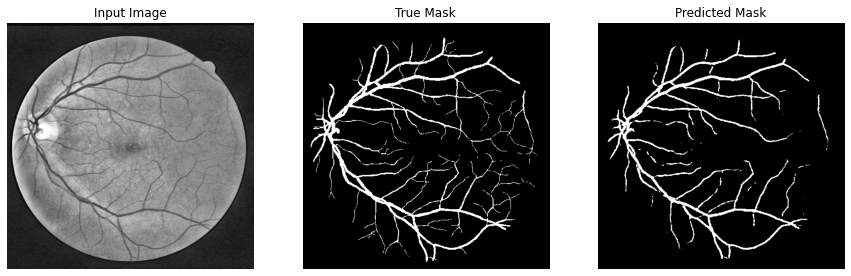


Sample Prediction after epoch 156


Epoch 00156: val_accuracy did not improve from 0.95887
Epoch 157/400
2/2 [==============================] - 1s 596ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2138 - val_accuracy: 0.9589

Epoch 00157: val_accuracy improved from 0.95887 to 0.95888, saving model to ./unet_backbone_vgg19.h5

Epoch 00157: ReduceLROnPlateau reducing learning rate to 1e-07.
Epoch 158/400
2/2 [==============================] - 1s 583ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2136 - val_accuracy: 0.9589

Epoch 00158: val_accuracy improved from 0.95888 to 0.95889, saving model to ./unet_backbone_vgg19.h5
Epoch 159/400
2/2 [==============================] - 1s 579ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2135 - val_accuracy: 0.9589

Epoch 00159: val_accuracy did not improve from 0.95889
Epoch 160/400
2/2 [==============================] - 1s 589ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2134 - val_accuracy: 0.9589

Epoch 0016

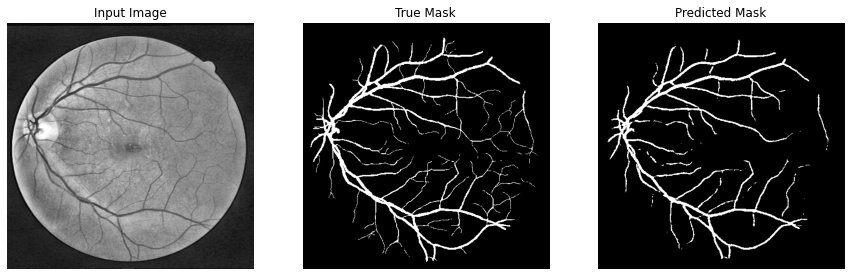


Sample Prediction after epoch 161


Epoch 00161: val_accuracy did not improve from 0.95889
Epoch 162/400
2/2 [==============================] - 2s 592ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2131 - val_accuracy: 0.9589

Epoch 00162: val_accuracy did not improve from 0.95889
Epoch 163/400
2/2 [==============================] - 2s 812ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2130 - val_accuracy: 0.9589

Epoch 00163: val_accuracy did not improve from 0.95889
Epoch 164/400
2/2 [==============================] - 2s 654ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2129 - val_accuracy: 0.9588

Epoch 00164: val_accuracy did not improve from 0.95889
Epoch 165/400
2/2 [==============================] - 1s 573ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2128 - val_accuracy: 0.9589

Epoch 00165: val_accuracy did not improve from 0.95889
Epoch 166/400
2/2 [==============================] - 1s 589ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss:

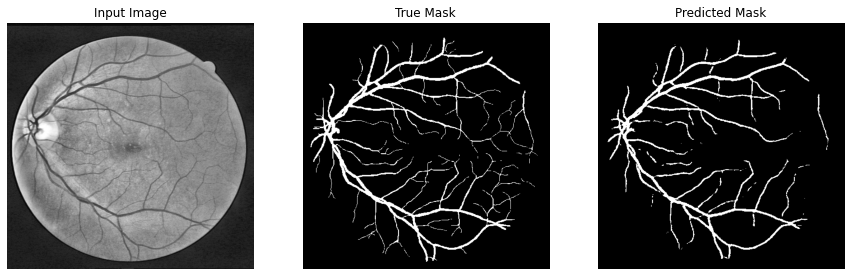


Sample Prediction after epoch 166


Epoch 00166: val_accuracy did not improve from 0.95889
Epoch 167/400
2/2 [==============================] - 1s 593ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2126 - val_accuracy: 0.9588

Epoch 00167: val_accuracy did not improve from 0.95889
Epoch 168/400
2/2 [==============================] - 1s 597ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2125 - val_accuracy: 0.9588

Epoch 00168: val_accuracy did not improve from 0.95889
Epoch 169/400
2/2 [==============================] - 1s 594ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2124 - val_accuracy: 0.9588

Epoch 00169: val_accuracy did not improve from 0.95889
Epoch 170/400
2/2 [==============================] - 1s 599ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2123 - val_accuracy: 0.9588

Epoch 00170: val_accuracy did not improve from 0.95889
Epoch 171/400
2/2 [==============================] - 1s 580ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss:

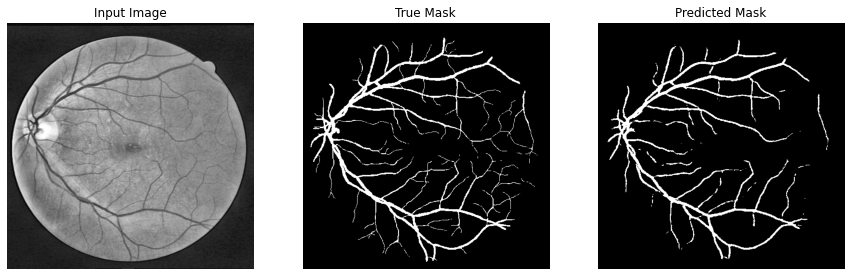


Sample Prediction after epoch 171


Epoch 00171: val_accuracy did not improve from 0.95889
Epoch 172/400
2/2 [==============================] - 1s 589ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2121 - val_accuracy: 0.9588

Epoch 00172: val_accuracy did not improve from 0.95889
Epoch 173/400
2/2 [==============================] - 1s 606ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2121 - val_accuracy: 0.9588

Epoch 00173: val_accuracy did not improve from 0.95889
Epoch 174/400
2/2 [==============================] - 1s 592ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2120 - val_accuracy: 0.9588

Epoch 00174: val_accuracy did not improve from 0.95889
Epoch 175/400
2/2 [==============================] - 1s 583ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2119 - val_accuracy: 0.9588

Epoch 00175: val_accuracy did not improve from 0.95889
Epoch 176/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss:

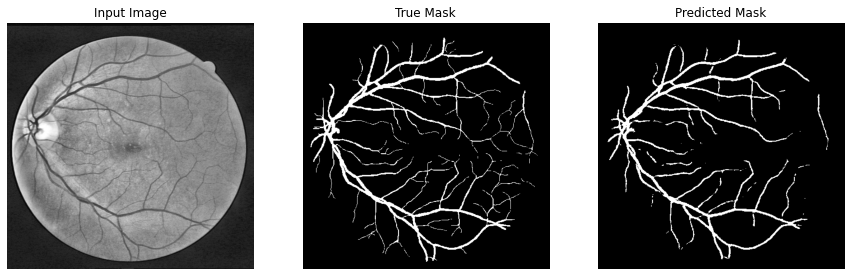


Sample Prediction after epoch 176


Epoch 00176: val_accuracy did not improve from 0.95889
Epoch 177/400
2/2 [==============================] - 1s 580ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2118 - val_accuracy: 0.9588

Epoch 00177: val_accuracy did not improve from 0.95889
Epoch 178/400
2/2 [==============================] - 1s 625ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2117 - val_accuracy: 0.9588

Epoch 00178: val_accuracy did not improve from 0.95889
Epoch 179/400
2/2 [==============================] - 1s 590ms/step - loss: 0.1958 - accuracy: 0.9673 - val_loss: 0.2117 - val_accuracy: 0.9588

Epoch 00179: val_accuracy did not improve from 0.95889
Epoch 180/400
2/2 [==============================] - 2s 676ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2116 - val_accuracy: 0.9588

Epoch 00180: val_accuracy did not improve from 0.95889
Epoch 181/400
2/2 [==============================] - 1s 595ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss:

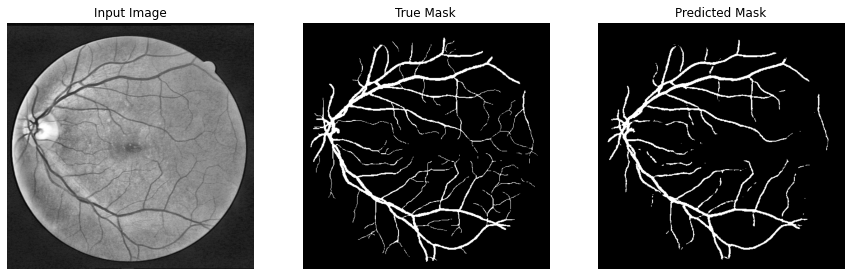


Sample Prediction after epoch 181


Epoch 00181: val_accuracy did not improve from 0.95889
Epoch 182/400
2/2 [==============================] - 1s 595ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2115 - val_accuracy: 0.9587

Epoch 00182: val_accuracy did not improve from 0.95889
Epoch 183/400
2/2 [==============================] - 2s 663ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2115 - val_accuracy: 0.9587

Epoch 00183: val_accuracy did not improve from 0.95889
Epoch 184/400
2/2 [==============================] - 1s 603ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2114 - val_accuracy: 0.9587

Epoch 00184: val_accuracy did not improve from 0.95889
Epoch 185/400
2/2 [==============================] - 1s 577ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2114 - val_accuracy: 0.9587

Epoch 00185: val_accuracy did not improve from 0.95889
Epoch 186/400
2/2 [==============================] - 1s 582ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss:

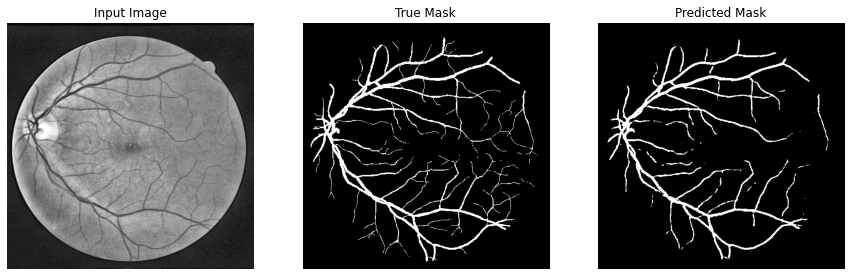


Sample Prediction after epoch 186


Epoch 00186: val_accuracy did not improve from 0.95889
Epoch 187/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2113 - val_accuracy: 0.9586

Epoch 00187: val_accuracy did not improve from 0.95889
Epoch 188/400
2/2 [==============================] - 1s 599ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2113 - val_accuracy: 0.9586

Epoch 00188: val_accuracy did not improve from 0.95889
Epoch 189/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2113 - val_accuracy: 0.9586

Epoch 00189: val_accuracy did not improve from 0.95889
Epoch 190/400
2/2 [==============================] - 1s 592ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9586

Epoch 00190: val_accuracy did not improve from 0.95889
Epoch 191/400
2/2 [==============================] - 1s 601ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss:

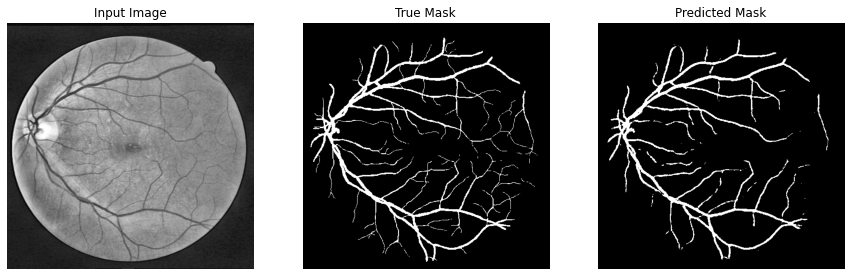


Sample Prediction after epoch 191


Epoch 00191: val_accuracy did not improve from 0.95889
Epoch 192/400
2/2 [==============================] - 1s 589ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9585

Epoch 00192: val_accuracy did not improve from 0.95889
Epoch 193/400
2/2 [==============================] - 1s 598ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9585

Epoch 00193: val_accuracy did not improve from 0.95889
Epoch 194/400
2/2 [==============================] - 1s 603ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9585

Epoch 00194: val_accuracy did not improve from 0.95889
Epoch 195/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9584

Epoch 00195: val_accuracy did not improve from 0.95889
Epoch 196/400
2/2 [==============================] - 1s 603ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss:

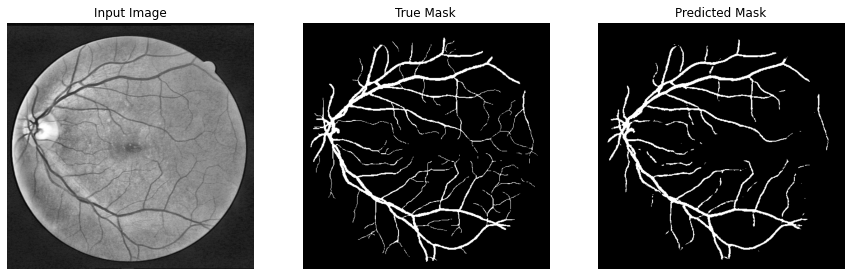


Sample Prediction after epoch 196


Epoch 00196: val_accuracy did not improve from 0.95889
Epoch 197/400
2/2 [==============================] - 1s 600ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9584

Epoch 00197: val_accuracy did not improve from 0.95889
Epoch 198/400
2/2 [==============================] - 1s 608ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9584

Epoch 00198: val_accuracy did not improve from 0.95889
Epoch 199/400
2/2 [==============================] - 2s 603ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9584

Epoch 00199: val_accuracy did not improve from 0.95889
Epoch 200/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9583

Epoch 00200: val_accuracy did not improve from 0.95889
Epoch 201/400
2/2 [==============================] - 1s 589ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss:

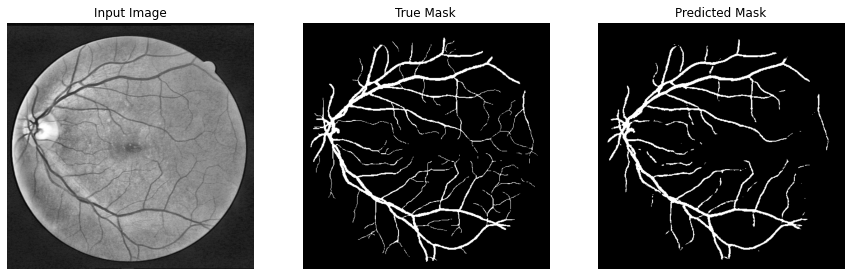


Sample Prediction after epoch 201


Epoch 00201: val_accuracy did not improve from 0.95889
Epoch 202/400
2/2 [==============================] - 2s 593ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9583

Epoch 00202: val_accuracy did not improve from 0.95889
Epoch 203/400
2/2 [==============================] - 1s 591ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9583

Epoch 00203: val_accuracy did not improve from 0.95889
Epoch 204/400
2/2 [==============================] - 1s 593ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9583

Epoch 00204: val_accuracy did not improve from 0.95889
Epoch 205/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9582

Epoch 00205: val_accuracy did not improve from 0.95889
Epoch 206/400
2/2 [==============================] - 1s 603ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss:

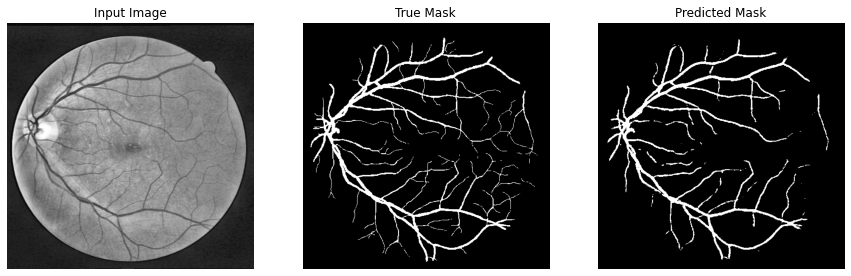


Sample Prediction after epoch 206


Epoch 00206: val_accuracy did not improve from 0.95889
Epoch 207/400
2/2 [==============================] - 1s 598ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9582

Epoch 00207: val_accuracy did not improve from 0.95889
Epoch 208/400
2/2 [==============================] - 2s 735ms/step - loss: 0.1957 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9582

Epoch 00208: val_accuracy did not improve from 0.95889
Epoch 209/400
2/2 [==============================] - 1s 596ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9581

Epoch 00209: val_accuracy did not improve from 0.95889
Epoch 210/400
2/2 [==============================] - 1s 602ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9581

Epoch 00210: val_accuracy did not improve from 0.95889
Epoch 211/400
2/2 [==============================] - 1s 575ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss:

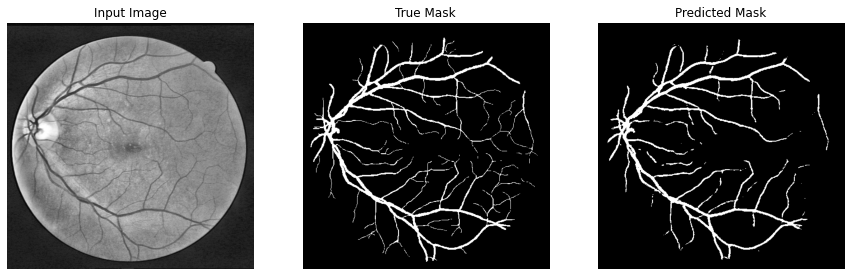


Sample Prediction after epoch 211


Epoch 00211: val_accuracy did not improve from 0.95889
Epoch 212/400
2/2 [==============================] - 1s 596ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9581

Epoch 00212: val_accuracy did not improve from 0.95889
Epoch 213/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9581

Epoch 00213: val_accuracy did not improve from 0.95889
Epoch 214/400
2/2 [==============================] - 1s 593ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2111 - val_accuracy: 0.9580

Epoch 00214: val_accuracy did not improve from 0.95889
Epoch 215/400
2/2 [==============================] - 1s 589ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9580

Epoch 00215: val_accuracy did not improve from 0.95889
Epoch 216/400
2/2 [==============================] - 2s 577ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss:

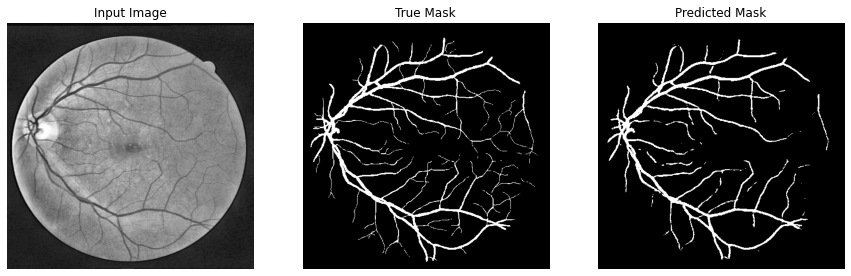


Sample Prediction after epoch 216


Epoch 00216: val_accuracy did not improve from 0.95889
Epoch 217/400
2/2 [==============================] - 1s 580ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9580

Epoch 00217: val_accuracy did not improve from 0.95889
Epoch 218/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9579

Epoch 00218: val_accuracy did not improve from 0.95889
Epoch 219/400
2/2 [==============================] - 2s 924ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9579

Epoch 00219: val_accuracy did not improve from 0.95889
Epoch 220/400
2/2 [==============================] - 1s 574ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2112 - val_accuracy: 0.9579

Epoch 00220: val_accuracy did not improve from 0.95889
Epoch 221/400
2/2 [==============================] - 2s 605ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss:

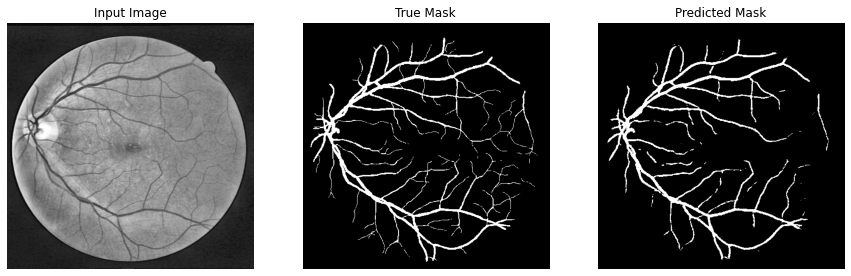


Sample Prediction after epoch 221


Epoch 00221: val_accuracy did not improve from 0.95889
Epoch 222/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2113 - val_accuracy: 0.9578

Epoch 00222: val_accuracy did not improve from 0.95889
Epoch 223/400
2/2 [==============================] - 1s 595ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2113 - val_accuracy: 0.9578

Epoch 00223: val_accuracy did not improve from 0.95889
Epoch 224/400
2/2 [==============================] - 1s 601ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2113 - val_accuracy: 0.9578

Epoch 00224: val_accuracy did not improve from 0.95889
Epoch 225/400
2/2 [==============================] - 1s 602ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2113 - val_accuracy: 0.9578

Epoch 00225: val_accuracy did not improve from 0.95889
Epoch 226/400
2/2 [==============================] - 1s 579ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss:

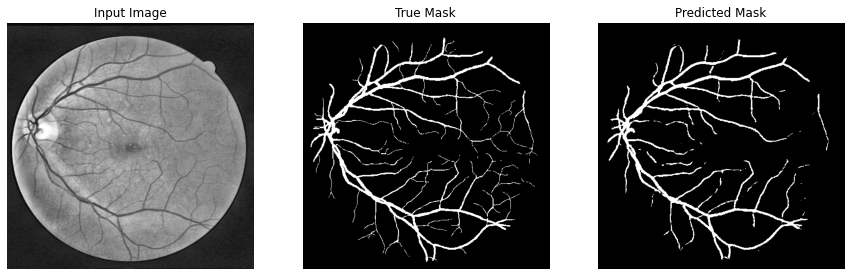


Sample Prediction after epoch 226


Epoch 00226: val_accuracy did not improve from 0.95889
Epoch 227/400
2/2 [==============================] - 1s 590ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2114 - val_accuracy: 0.9577

Epoch 00227: val_accuracy did not improve from 0.95889
Epoch 228/400
2/2 [==============================] - 1s 594ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2114 - val_accuracy: 0.9577

Epoch 00228: val_accuracy did not improve from 0.95889
Epoch 229/400
2/2 [==============================] - 2s 583ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2114 - val_accuracy: 0.9576

Epoch 00229: val_accuracy did not improve from 0.95889
Epoch 230/400
2/2 [==============================] - 1s 597ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2114 - val_accuracy: 0.9576

Epoch 00230: val_accuracy did not improve from 0.95889
Epoch 231/400
2/2 [==============================] - 1s 591ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss:

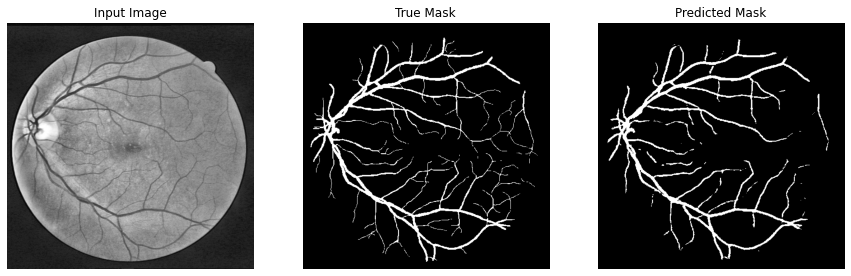


Sample Prediction after epoch 231


Epoch 00231: val_accuracy did not improve from 0.95889
Epoch 232/400
2/2 [==============================] - 2s 658ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2115 - val_accuracy: 0.9576

Epoch 00232: val_accuracy did not improve from 0.95889
Epoch 233/400
2/2 [==============================] - 1s 576ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2115 - val_accuracy: 0.9575

Epoch 00233: val_accuracy did not improve from 0.95889
Epoch 234/400
2/2 [==============================] - 1s 609ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2115 - val_accuracy: 0.9575

Epoch 00234: val_accuracy did not improve from 0.95889
Epoch 235/400
2/2 [==============================] - 1s 578ms/step - loss: 0.1956 - accuracy: 0.9673 - val_loss: 0.2115 - val_accuracy: 0.9575

Epoch 00235: val_accuracy did not improve from 0.95889
Epoch 236/400
2/2 [==============================] - 1s 604ms/step - loss: 0.1956 - accuracy: 0.9674 - val_loss:

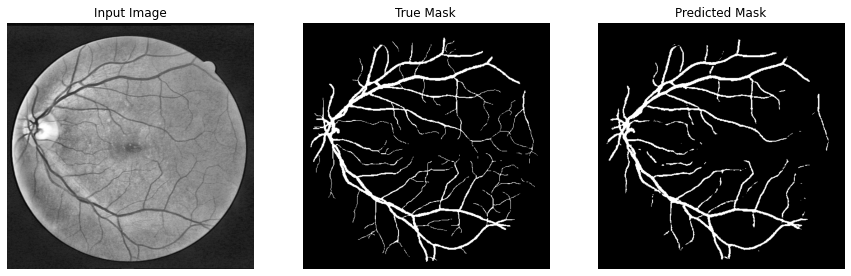


Sample Prediction after epoch 236


Epoch 00236: val_accuracy did not improve from 0.95889
Epoch 237/400
2/2 [==============================] - 1s 605ms/step - loss: 0.1956 - accuracy: 0.9674 - val_loss: 0.2116 - val_accuracy: 0.9574

Epoch 00237: val_accuracy did not improve from 0.95889
Epoch 238/400
2/2 [==============================] - 1s 597ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2116 - val_accuracy: 0.9574

Epoch 00238: val_accuracy did not improve from 0.95889
Epoch 239/400
2/2 [==============================] - 1s 590ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2116 - val_accuracy: 0.9574

Epoch 00239: val_accuracy did not improve from 0.95889
Epoch 240/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2117 - val_accuracy: 0.9574

Epoch 00240: val_accuracy did not improve from 0.95889
Epoch 241/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss:

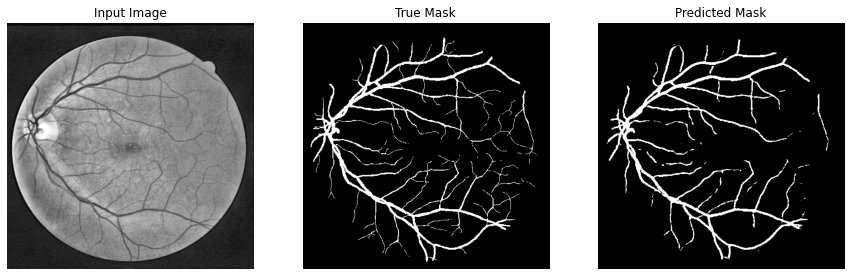


Sample Prediction after epoch 241


Epoch 00241: val_accuracy did not improve from 0.95889
Epoch 242/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2117 - val_accuracy: 0.9573

Epoch 00242: val_accuracy did not improve from 0.95889
Epoch 243/400
2/2 [==============================] - 1s 601ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2117 - val_accuracy: 0.9573

Epoch 00243: val_accuracy did not improve from 0.95889
Epoch 244/400
2/2 [==============================] - 2s 586ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2118 - val_accuracy: 0.9573

Epoch 00244: val_accuracy did not improve from 0.95889
Epoch 245/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2118 - val_accuracy: 0.9573

Epoch 00245: val_accuracy did not improve from 0.95889
Epoch 246/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss:

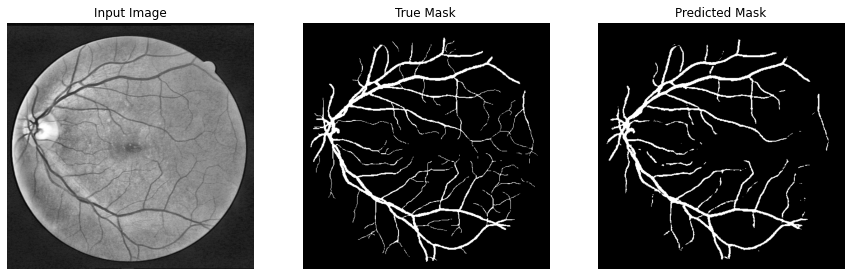


Sample Prediction after epoch 246


Epoch 00246: val_accuracy did not improve from 0.95889
Epoch 247/400
2/2 [==============================] - 1s 596ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2118 - val_accuracy: 0.9572

Epoch 00247: val_accuracy did not improve from 0.95889
Epoch 248/400
2/2 [==============================] - 2s 802ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2119 - val_accuracy: 0.9572

Epoch 00248: val_accuracy did not improve from 0.95889
Epoch 249/400
2/2 [==============================] - 2s 891ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2119 - val_accuracy: 0.9571

Epoch 00249: val_accuracy did not improve from 0.95889
Epoch 250/400
2/2 [==============================] - 2s 591ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2119 - val_accuracy: 0.9571

Epoch 00250: val_accuracy did not improve from 0.95889
Epoch 251/400
2/2 [==============================] - 1s 582ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss:

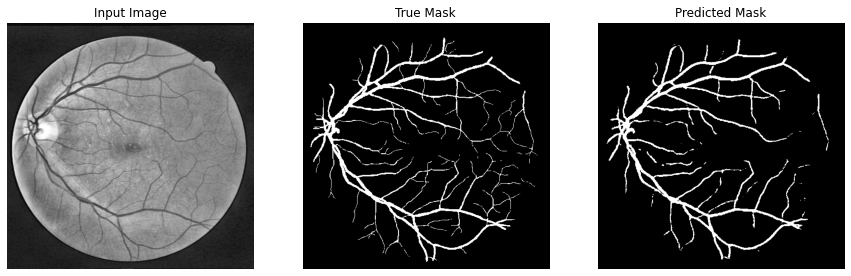


Sample Prediction after epoch 251


Epoch 00251: val_accuracy did not improve from 0.95889
Epoch 252/400
2/2 [==============================] - 1s 579ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2120 - val_accuracy: 0.9571

Epoch 00252: val_accuracy did not improve from 0.95889
Epoch 253/400
2/2 [==============================] - 1s 564ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2120 - val_accuracy: 0.9571

Epoch 00253: val_accuracy did not improve from 0.95889
Epoch 254/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2120 - val_accuracy: 0.9570

Epoch 00254: val_accuracy did not improve from 0.95889
Epoch 255/400
2/2 [==============================] - 1s 573ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2120 - val_accuracy: 0.9570

Epoch 00255: val_accuracy did not improve from 0.95889
Epoch 256/400
2/2 [==============================] - 2s 603ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss:

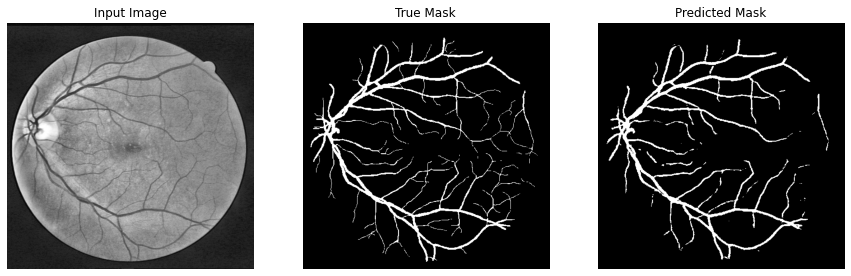


Sample Prediction after epoch 256


Epoch 00256: val_accuracy did not improve from 0.95889
Epoch 257/400
2/2 [==============================] - 1s 575ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2121 - val_accuracy: 0.9570

Epoch 00257: val_accuracy did not improve from 0.95889
Epoch 258/400
2/2 [==============================] - 1s 593ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2121 - val_accuracy: 0.9570

Epoch 00258: val_accuracy did not improve from 0.95889
Epoch 259/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2121 - val_accuracy: 0.9569

Epoch 00259: val_accuracy did not improve from 0.95889
Epoch 260/400
2/2 [==============================] - 1s 589ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2121 - val_accuracy: 0.9569

Epoch 00260: val_accuracy did not improve from 0.95889
Epoch 261/400
2/2 [==============================] - 1s 599ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss:

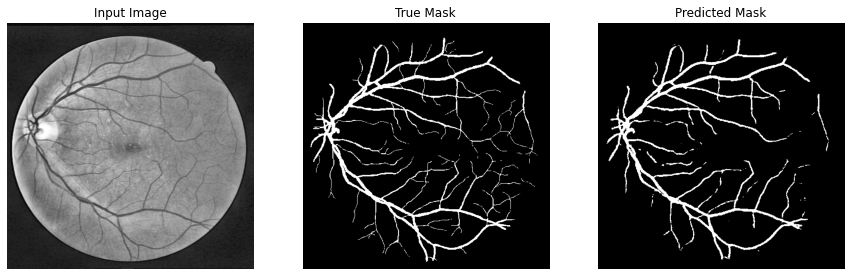


Sample Prediction after epoch 261


Epoch 00261: val_accuracy did not improve from 0.95889
Epoch 262/400
2/2 [==============================] - 1s 582ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2122 - val_accuracy: 0.9569

Epoch 00262: val_accuracy did not improve from 0.95889
Epoch 263/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2122 - val_accuracy: 0.9569

Epoch 00263: val_accuracy did not improve from 0.95889
Epoch 264/400
2/2 [==============================] - 1s 597ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2122 - val_accuracy: 0.9569

Epoch 00264: val_accuracy did not improve from 0.95889
Epoch 265/400
2/2 [==============================] - 1s 577ms/step - loss: 0.1955 - accuracy: 0.9674 - val_loss: 0.2123 - val_accuracy: 0.9568

Epoch 00265: val_accuracy did not improve from 0.95889
Epoch 266/400
2/2 [==============================] - 2s 789ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss:

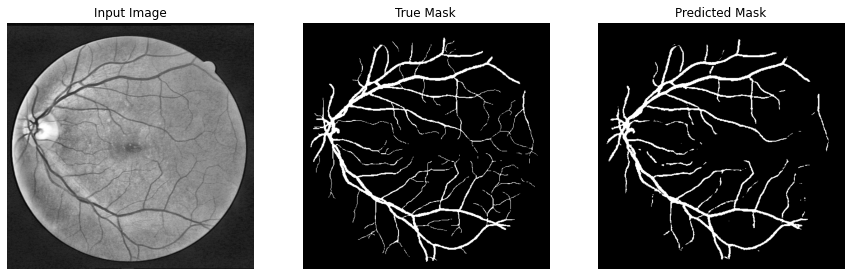


Sample Prediction after epoch 266


Epoch 00266: val_accuracy did not improve from 0.95889
Epoch 267/400
2/2 [==============================] - 2s 765ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2123 - val_accuracy: 0.9568

Epoch 00267: val_accuracy did not improve from 0.95889
Epoch 268/400
2/2 [==============================] - 2s 563ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2123 - val_accuracy: 0.9568

Epoch 00268: val_accuracy did not improve from 0.95889
Epoch 269/400
2/2 [==============================] - 1s 578ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2124 - val_accuracy: 0.9568

Epoch 00269: val_accuracy did not improve from 0.95889
Epoch 270/400
2/2 [==============================] - 1s 572ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2124 - val_accuracy: 0.9568

Epoch 00270: val_accuracy did not improve from 0.95889
Epoch 271/400
2/2 [==============================] - 1s 602ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss:

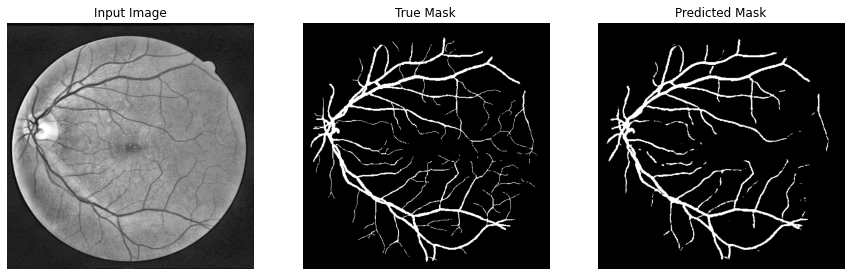


Sample Prediction after epoch 271


Epoch 00271: val_accuracy did not improve from 0.95889
Epoch 272/400
2/2 [==============================] - 1s 592ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2124 - val_accuracy: 0.9568

Epoch 00272: val_accuracy did not improve from 0.95889
Epoch 273/400
2/2 [==============================] - 1s 570ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2124 - val_accuracy: 0.9567

Epoch 00273: val_accuracy did not improve from 0.95889
Epoch 274/400
2/2 [==============================] - 1s 616ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2125 - val_accuracy: 0.9567

Epoch 00274: val_accuracy did not improve from 0.95889
Epoch 275/400
2/2 [==============================] - 2s 575ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2125 - val_accuracy: 0.9567

Epoch 00275: val_accuracy did not improve from 0.95889
Epoch 276/400
2/2 [==============================] - 1s 570ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss:

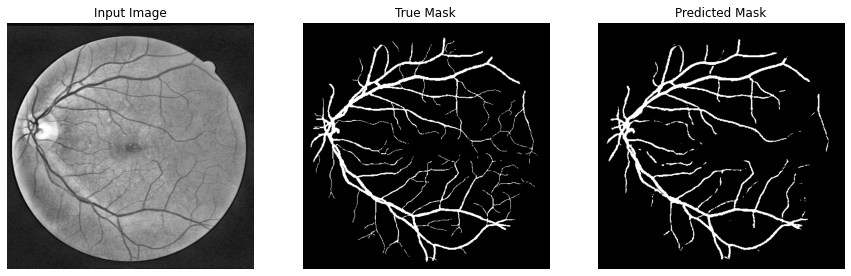


Sample Prediction after epoch 276


Epoch 00276: val_accuracy did not improve from 0.95889
Epoch 277/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2125 - val_accuracy: 0.9567

Epoch 00277: val_accuracy did not improve from 0.95889
Epoch 278/400
2/2 [==============================] - 1s 592ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2125 - val_accuracy: 0.9567

Epoch 00278: val_accuracy did not improve from 0.95889
Epoch 279/400
2/2 [==============================] - 1s 595ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2126 - val_accuracy: 0.9566

Epoch 00279: val_accuracy did not improve from 0.95889
Epoch 280/400
2/2 [==============================] - 1s 593ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2126 - val_accuracy: 0.9566

Epoch 00280: val_accuracy did not improve from 0.95889
Epoch 281/400
2/2 [==============================] - 2s 919ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss:

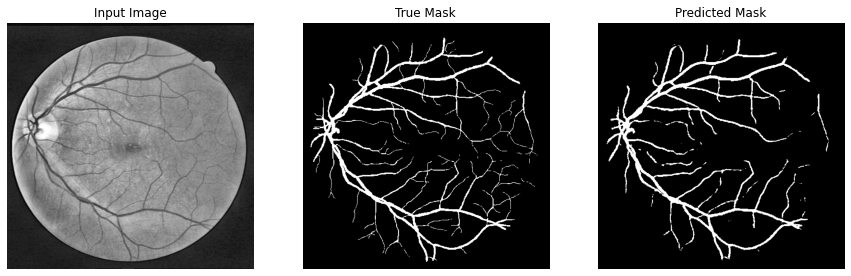


Sample Prediction after epoch 281


Epoch 00281: val_accuracy did not improve from 0.95889
Epoch 282/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2126 - val_accuracy: 0.9566

Epoch 00282: val_accuracy did not improve from 0.95889
Epoch 283/400
2/2 [==============================] - 1s 582ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2126 - val_accuracy: 0.9566

Epoch 00283: val_accuracy did not improve from 0.95889
Epoch 284/400
2/2 [==============================] - 2s 810ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2127 - val_accuracy: 0.9566

Epoch 00284: val_accuracy did not improve from 0.95889
Epoch 285/400
2/2 [==============================] - 2s 990ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2127 - val_accuracy: 0.9566

Epoch 00285: val_accuracy did not improve from 0.95889
Epoch 286/400
2/2 [==============================] - 2s 798ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss:

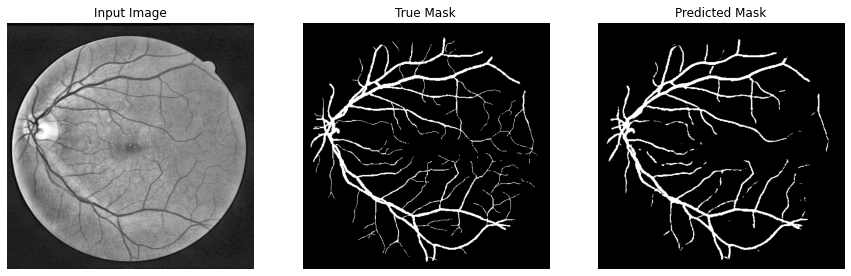


Sample Prediction after epoch 286


Epoch 00286: val_accuracy did not improve from 0.95889
Epoch 287/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2127 - val_accuracy: 0.9566

Epoch 00287: val_accuracy did not improve from 0.95889
Epoch 288/400
2/2 [==============================] - 1s 576ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2127 - val_accuracy: 0.9566

Epoch 00288: val_accuracy did not improve from 0.95889
Epoch 289/400
2/2 [==============================] - 1s 596ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2128 - val_accuracy: 0.9566

Epoch 00289: val_accuracy did not improve from 0.95889
Epoch 290/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2128 - val_accuracy: 0.9565

Epoch 00290: val_accuracy did not improve from 0.95889
Epoch 291/400
2/2 [==============================] - 1s 591ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss:

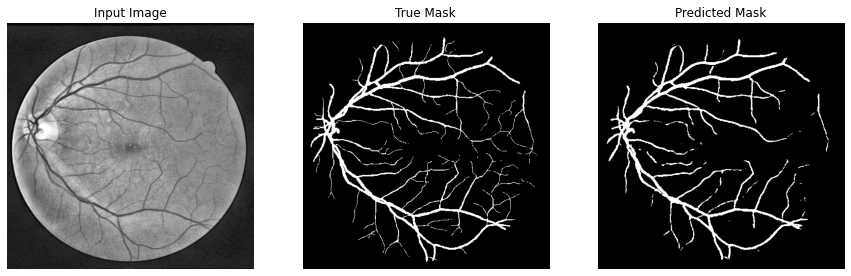


Sample Prediction after epoch 291


Epoch 00291: val_accuracy did not improve from 0.95889
Epoch 292/400
2/2 [==============================] - 1s 627ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2128 - val_accuracy: 0.9565

Epoch 00292: val_accuracy did not improve from 0.95889
Epoch 293/400
2/2 [==============================] - 1s 576ms/step - loss: 0.1954 - accuracy: 0.9674 - val_loss: 0.2128 - val_accuracy: 0.9565

Epoch 00293: val_accuracy did not improve from 0.95889
Epoch 294/400
2/2 [==============================] - 1s 625ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2128 - val_accuracy: 0.9565

Epoch 00294: val_accuracy did not improve from 0.95889
Epoch 295/400
2/2 [==============================] - 1s 586ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2129 - val_accuracy: 0.9565

Epoch 00295: val_accuracy did not improve from 0.95889
Epoch 296/400
2/2 [==============================] - 1s 603ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss:

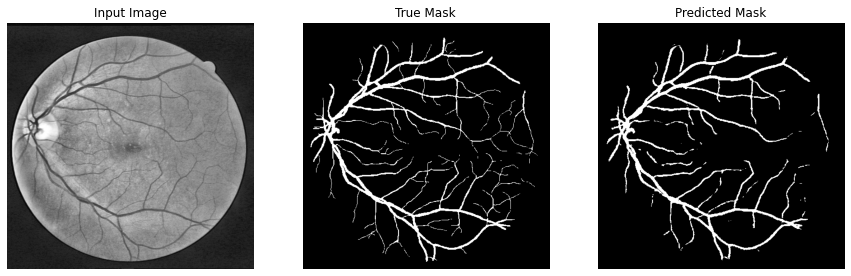


Sample Prediction after epoch 296


Epoch 00296: val_accuracy did not improve from 0.95889
Epoch 297/400
2/2 [==============================] - 1s 591ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2129 - val_accuracy: 0.9565

Epoch 00297: val_accuracy did not improve from 0.95889
Epoch 298/400
2/2 [==============================] - 2s 760ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2129 - val_accuracy: 0.9564

Epoch 00298: val_accuracy did not improve from 0.95889
Epoch 299/400
2/2 [==============================] - 1s 594ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2129 - val_accuracy: 0.9564

Epoch 00299: val_accuracy did not improve from 0.95889
Epoch 300/400
2/2 [==============================] - 1s 604ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2129 - val_accuracy: 0.9564

Epoch 00300: val_accuracy did not improve from 0.95889
Epoch 301/400
2/2 [==============================] - 2s 791ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss:

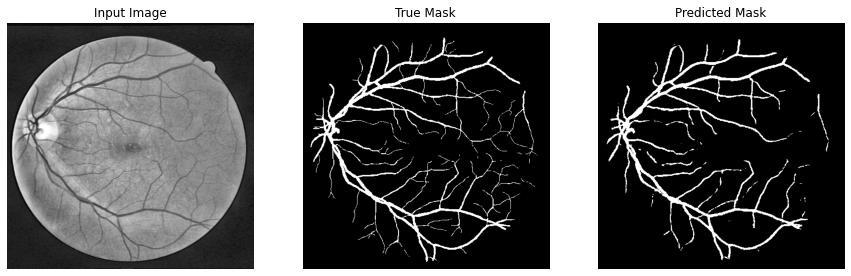


Sample Prediction after epoch 301


Epoch 00301: val_accuracy did not improve from 0.95889
Epoch 302/400
2/2 [==============================] - 2s 735ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2130 - val_accuracy: 0.9564

Epoch 00302: val_accuracy did not improve from 0.95889
Epoch 303/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2130 - val_accuracy: 0.9564

Epoch 00303: val_accuracy did not improve from 0.95889
Epoch 304/400
2/2 [==============================] - 2s 766ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2130 - val_accuracy: 0.9564

Epoch 00304: val_accuracy did not improve from 0.95889
Epoch 305/400
2/2 [==============================] - 1s 602ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2130 - val_accuracy: 0.9564

Epoch 00305: val_accuracy did not improve from 0.95889
Epoch 306/400
2/2 [==============================] - 1s 578ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss:

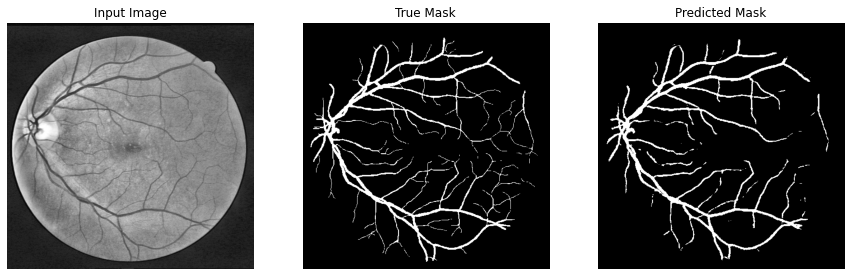


Sample Prediction after epoch 306


Epoch 00306: val_accuracy did not improve from 0.95889
Epoch 307/400
2/2 [==============================] - 1s 617ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2130 - val_accuracy: 0.9563

Epoch 00307: val_accuracy did not improve from 0.95889
Epoch 308/400
2/2 [==============================] - 1s 583ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2130 - val_accuracy: 0.9563

Epoch 00308: val_accuracy did not improve from 0.95889
Epoch 309/400
2/2 [==============================] - 1s 597ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2131 - val_accuracy: 0.9563

Epoch 00309: val_accuracy did not improve from 0.95889
Epoch 310/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2131 - val_accuracy: 0.9563

Epoch 00310: val_accuracy did not improve from 0.95889
Epoch 311/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss:

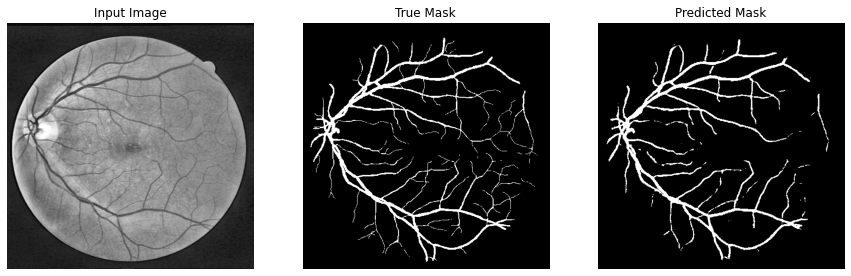


Sample Prediction after epoch 311


Epoch 00311: val_accuracy did not improve from 0.95889
Epoch 312/400
2/2 [==============================] - 1s 579ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2131 - val_accuracy: 0.9563

Epoch 00312: val_accuracy did not improve from 0.95889
Epoch 313/400
2/2 [==============================] - 1s 602ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2131 - val_accuracy: 0.9563

Epoch 00313: val_accuracy did not improve from 0.95889
Epoch 314/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2131 - val_accuracy: 0.9563

Epoch 00314: val_accuracy did not improve from 0.95889
Epoch 315/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2131 - val_accuracy: 0.9563

Epoch 00315: val_accuracy did not improve from 0.95889
Epoch 316/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss:

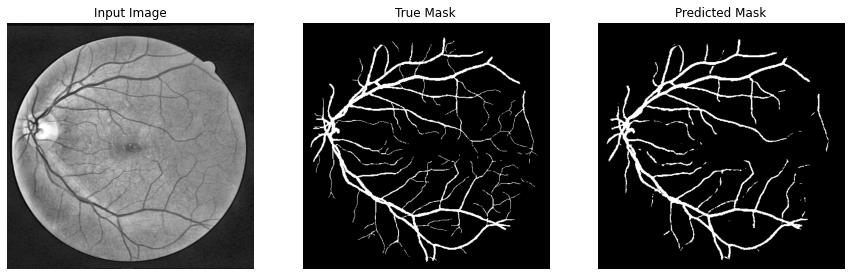


Sample Prediction after epoch 316


Epoch 00316: val_accuracy did not improve from 0.95889
Epoch 317/400
2/2 [==============================] - 2s 744ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2132 - val_accuracy: 0.9563

Epoch 00317: val_accuracy did not improve from 0.95889
Epoch 318/400
2/2 [==============================] - 1s 578ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2132 - val_accuracy: 0.9562

Epoch 00318: val_accuracy did not improve from 0.95889
Epoch 319/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2132 - val_accuracy: 0.9562

Epoch 00319: val_accuracy did not improve from 0.95889
Epoch 320/400
2/2 [==============================] - 1s 609ms/step - loss: 0.1953 - accuracy: 0.9674 - val_loss: 0.2132 - val_accuracy: 0.9562

Epoch 00320: val_accuracy did not improve from 0.95889
Epoch 321/400
2/2 [==============================] - 1s 579ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss:

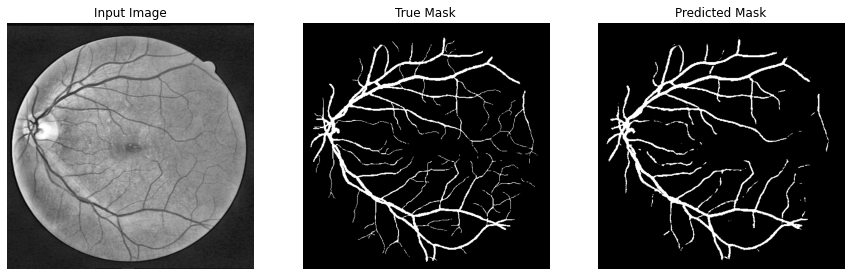


Sample Prediction after epoch 321


Epoch 00321: val_accuracy did not improve from 0.95889
Epoch 322/400
2/2 [==============================] - 1s 611ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2132 - val_accuracy: 0.9562

Epoch 00322: val_accuracy did not improve from 0.95889
Epoch 323/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2132 - val_accuracy: 0.9562

Epoch 00323: val_accuracy did not improve from 0.95889
Epoch 324/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2132 - val_accuracy: 0.9562

Epoch 00324: val_accuracy did not improve from 0.95889
Epoch 325/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2132 - val_accuracy: 0.9562

Epoch 00325: val_accuracy did not improve from 0.95889
Epoch 326/400
2/2 [==============================] - 1s 602ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss:

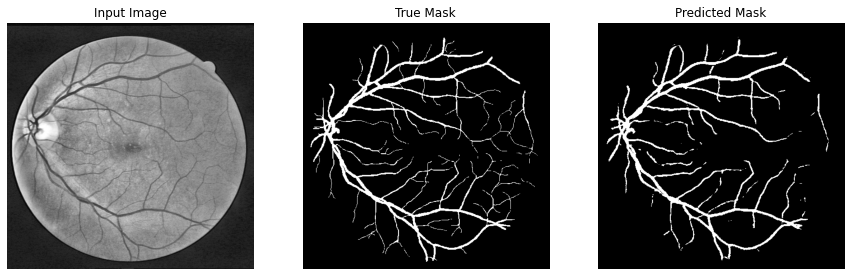


Sample Prediction after epoch 326


Epoch 00326: val_accuracy did not improve from 0.95889
Epoch 327/400
2/2 [==============================] - 2s 660ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2133 - val_accuracy: 0.9562

Epoch 00327: val_accuracy did not improve from 0.95889
Epoch 328/400
2/2 [==============================] - 1s 589ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2133 - val_accuracy: 0.9562

Epoch 00328: val_accuracy did not improve from 0.95889
Epoch 329/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2133 - val_accuracy: 0.9562

Epoch 00329: val_accuracy did not improve from 0.95889
Epoch 330/400
2/2 [==============================] - 1s 579ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2133 - val_accuracy: 0.9562

Epoch 00330: val_accuracy did not improve from 0.95889
Epoch 331/400
2/2 [==============================] - 1s 590ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss:

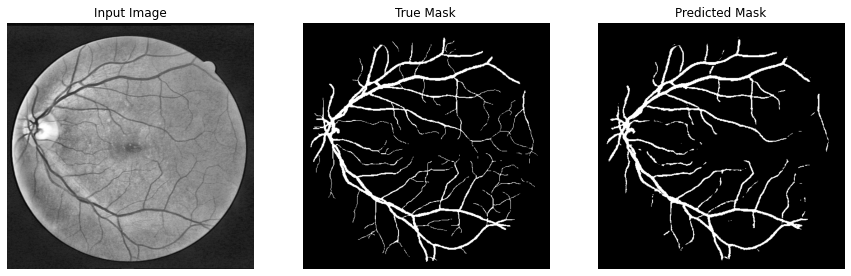


Sample Prediction after epoch 331


Epoch 00331: val_accuracy did not improve from 0.95889
Epoch 332/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2133 - val_accuracy: 0.9561

Epoch 00332: val_accuracy did not improve from 0.95889
Epoch 333/400
2/2 [==============================] - 1s 640ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2133 - val_accuracy: 0.9561

Epoch 00333: val_accuracy did not improve from 0.95889
Epoch 334/400
2/2 [==============================] - 2s 579ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2133 - val_accuracy: 0.9561

Epoch 00334: val_accuracy did not improve from 0.95889
Epoch 335/400
2/2 [==============================] - 2s 974ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2133 - val_accuracy: 0.9561

Epoch 00335: val_accuracy did not improve from 0.95889
Epoch 336/400
2/2 [==============================] - 1s 570ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss:

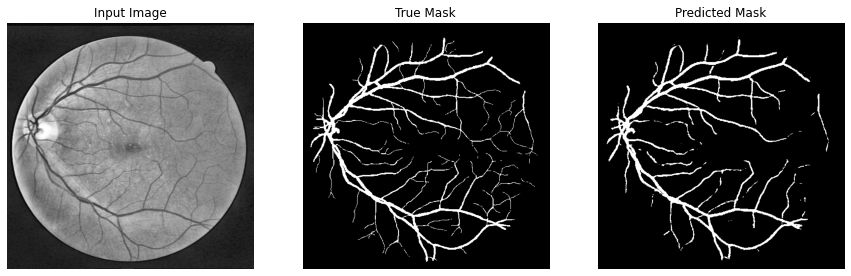


Sample Prediction after epoch 336


Epoch 00336: val_accuracy did not improve from 0.95889
Epoch 337/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00337: val_accuracy did not improve from 0.95889
Epoch 338/400
2/2 [==============================] - 1s 582ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00338: val_accuracy did not improve from 0.95889
Epoch 339/400
2/2 [==============================] - 1s 603ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00339: val_accuracy did not improve from 0.95889
Epoch 340/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00340: val_accuracy did not improve from 0.95889
Epoch 341/400
2/2 [==============================] - 1s 572ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss:

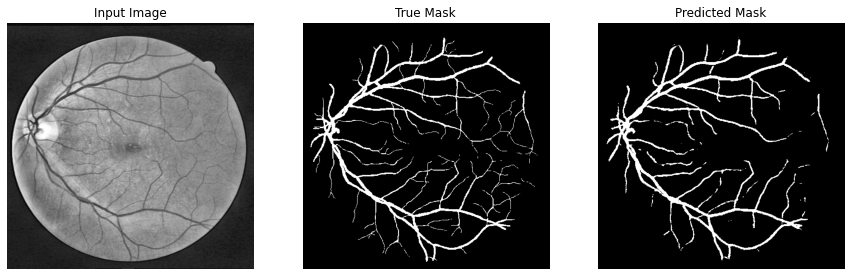


Sample Prediction after epoch 341


Epoch 00341: val_accuracy did not improve from 0.95889
Epoch 342/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00342: val_accuracy did not improve from 0.95889
Epoch 343/400
2/2 [==============================] - 1s 577ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00343: val_accuracy did not improve from 0.95889
Epoch 344/400
2/2 [==============================] - 1s 605ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00344: val_accuracy did not improve from 0.95889
Epoch 345/400
2/2 [==============================] - 1s 582ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00345: val_accuracy did not improve from 0.95889
Epoch 346/400
2/2 [==============================] - 1s 580ms/step - loss: 0.1952 - accuracy: 0.9674 - val_loss:

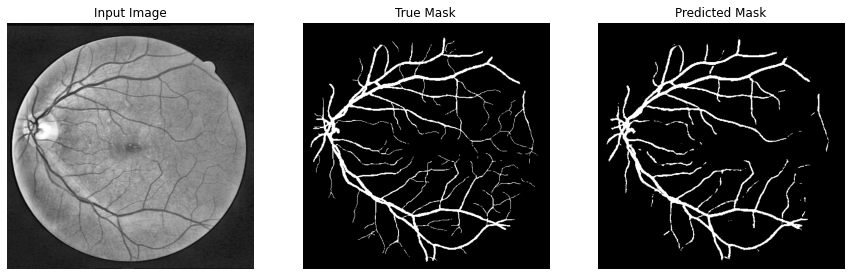


Sample Prediction after epoch 346


Epoch 00346: val_accuracy did not improve from 0.95889
Epoch 347/400
2/2 [==============================] - 1s 580ms/step - loss: 0.1951 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00347: val_accuracy did not improve from 0.95889
Epoch 348/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1951 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00348: val_accuracy did not improve from 0.95889
Epoch 349/400
2/2 [==============================] - 1s 597ms/step - loss: 0.1951 - accuracy: 0.9674 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00349: val_accuracy did not improve from 0.95889
Epoch 350/400
2/2 [==============================] - 1s 582ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00350: val_accuracy did not improve from 0.95889
Epoch 351/400
2/2 [==============================] - 1s 607ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss:

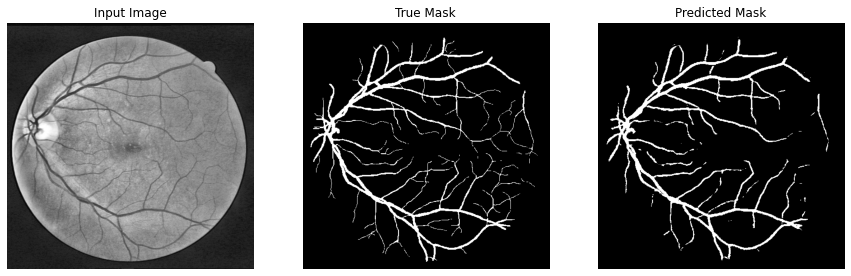


Sample Prediction after epoch 351


Epoch 00351: val_accuracy did not improve from 0.95889
Epoch 352/400
2/2 [==============================] - 2s 794ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2134 - val_accuracy: 0.9561

Epoch 00352: val_accuracy did not improve from 0.95889
Epoch 353/400
2/2 [==============================] - 1s 595ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9561

Epoch 00353: val_accuracy did not improve from 0.95889
Epoch 354/400
2/2 [==============================] - 1s 576ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00354: val_accuracy did not improve from 0.95889
Epoch 355/400
2/2 [==============================] - 1s 591ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00355: val_accuracy did not improve from 0.95889
Epoch 356/400
2/2 [==============================] - 1s 591ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss:

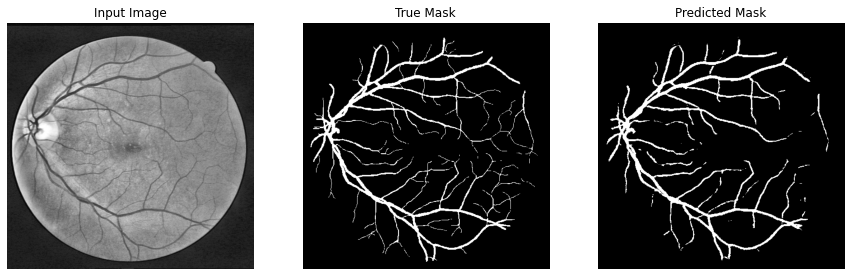


Sample Prediction after epoch 356


Epoch 00356: val_accuracy did not improve from 0.95889
Epoch 357/400
2/2 [==============================] - 1s 571ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00357: val_accuracy did not improve from 0.95889
Epoch 358/400
2/2 [==============================] - 1s 599ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00358: val_accuracy did not improve from 0.95889
Epoch 359/400
2/2 [==============================] - 1s 599ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00359: val_accuracy did not improve from 0.95889
Epoch 360/400
2/2 [==============================] - 1s 582ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00360: val_accuracy did not improve from 0.95889
Epoch 361/400
2/2 [==============================] - 1s 590ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss:

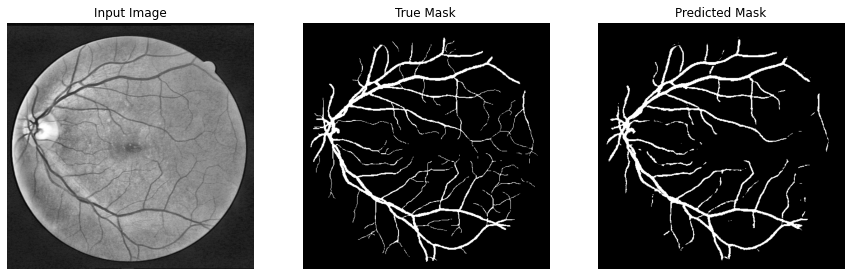


Sample Prediction after epoch 361


Epoch 00361: val_accuracy did not improve from 0.95889
Epoch 362/400
2/2 [==============================] - 1s 583ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00362: val_accuracy did not improve from 0.95889
Epoch 363/400
2/2 [==============================] - 1s 590ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00363: val_accuracy did not improve from 0.95889
Epoch 364/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00364: val_accuracy did not improve from 0.95889
Epoch 365/400
2/2 [==============================] - 1s 577ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00365: val_accuracy did not improve from 0.95889
Epoch 366/400
2/2 [==============================] - 1s 594ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss:

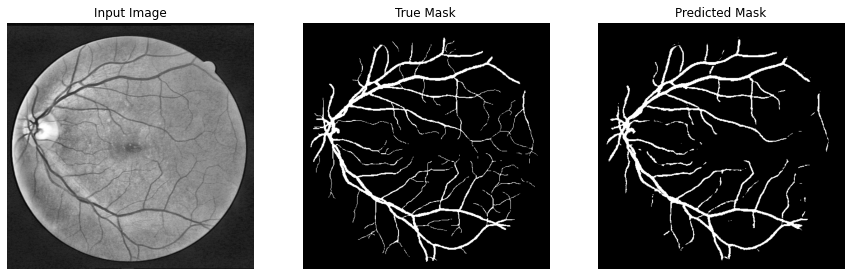


Sample Prediction after epoch 366


Epoch 00366: val_accuracy did not improve from 0.95889
Epoch 367/400
2/2 [==============================] - 1s 583ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00367: val_accuracy did not improve from 0.95889
Epoch 368/400
2/2 [==============================] - 2s 991ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00368: val_accuracy did not improve from 0.95889
Epoch 369/400
2/2 [==============================] - 1s 626ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00369: val_accuracy did not improve from 0.95889
Epoch 370/400
2/2 [==============================] - 2s 964ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00370: val_accuracy did not improve from 0.95889
Epoch 371/400
2/2 [==============================] - 1s 570ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss:

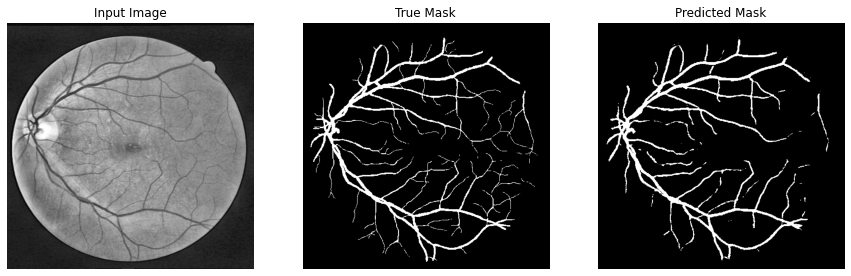


Sample Prediction after epoch 371


Epoch 00371: val_accuracy did not improve from 0.95889
Epoch 372/400
2/2 [==============================] - 1s 576ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00372: val_accuracy did not improve from 0.95889
Epoch 373/400
2/2 [==============================] - 1s 586ms/step - loss: 0.1951 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00373: val_accuracy did not improve from 0.95889
Epoch 374/400
2/2 [==============================] - 1s 593ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00374: val_accuracy did not improve from 0.95889
Epoch 375/400
2/2 [==============================] - 2s 751ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00375: val_accuracy did not improve from 0.95889
Epoch 376/400
2/2 [==============================] - 1s 573ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss:

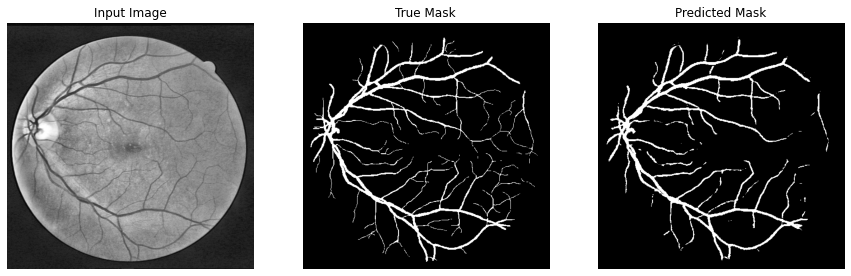


Sample Prediction after epoch 376


Epoch 00376: val_accuracy did not improve from 0.95889
Epoch 377/400
2/2 [==============================] - 1s 596ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2135 - val_accuracy: 0.9560

Epoch 00377: val_accuracy did not improve from 0.95889
Epoch 378/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9560

Epoch 00378: val_accuracy did not improve from 0.95889
Epoch 379/400
2/2 [==============================] - 1s 601ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9560

Epoch 00379: val_accuracy did not improve from 0.95889
Epoch 380/400
2/2 [==============================] - 1s 581ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9560

Epoch 00380: val_accuracy did not improve from 0.95889
Epoch 381/400
2/2 [==============================] - 1s 577ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss:

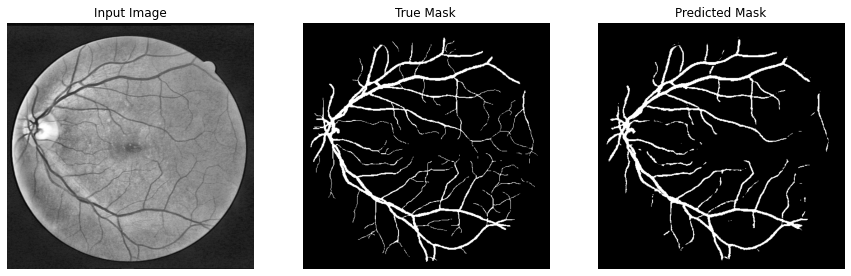


Sample Prediction after epoch 381


Epoch 00381: val_accuracy did not improve from 0.95889
Epoch 382/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9560

Epoch 00382: val_accuracy did not improve from 0.95889
Epoch 383/400
2/2 [==============================] - 1s 581ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9560

Epoch 00383: val_accuracy did not improve from 0.95889
Epoch 384/400
2/2 [==============================] - 1s 591ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9560

Epoch 00384: val_accuracy did not improve from 0.95889
Epoch 385/400
2/2 [==============================] - 1s 594ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9560

Epoch 00385: val_accuracy did not improve from 0.95889
Epoch 386/400
2/2 [==============================] - 2s 758ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss:

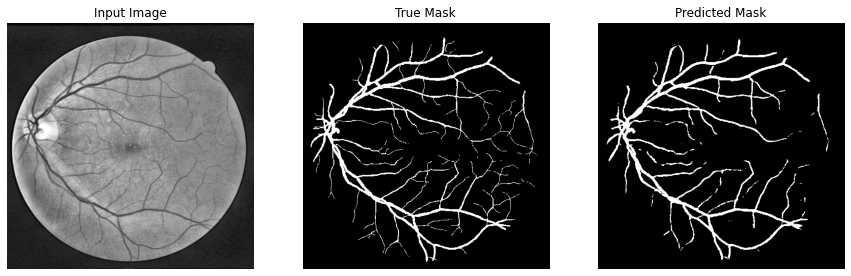


Sample Prediction after epoch 386


Epoch 00386: val_accuracy did not improve from 0.95889
Epoch 387/400
2/2 [==============================] - 2s 928ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00387: val_accuracy did not improve from 0.95889
Epoch 388/400
2/2 [==============================] - 1s 588ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00388: val_accuracy did not improve from 0.95889
Epoch 389/400
2/2 [==============================] - 1s 586ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00389: val_accuracy did not improve from 0.95889
Epoch 390/400
2/2 [==============================] - 1s 584ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00390: val_accuracy did not improve from 0.95889
Epoch 391/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss:

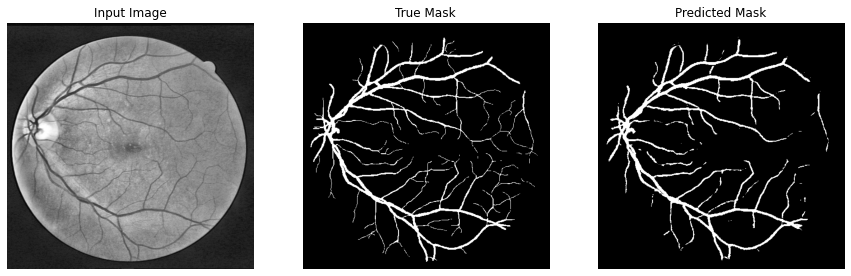


Sample Prediction after epoch 391


Epoch 00391: val_accuracy did not improve from 0.95889
Epoch 392/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00392: val_accuracy did not improve from 0.95889
Epoch 393/400
2/2 [==============================] - 1s 613ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00393: val_accuracy did not improve from 0.95889
Epoch 394/400
2/2 [==============================] - 1s 597ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00394: val_accuracy did not improve from 0.95889
Epoch 395/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00395: val_accuracy did not improve from 0.95889
Epoch 396/400
2/2 [==============================] - 1s 596ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss:

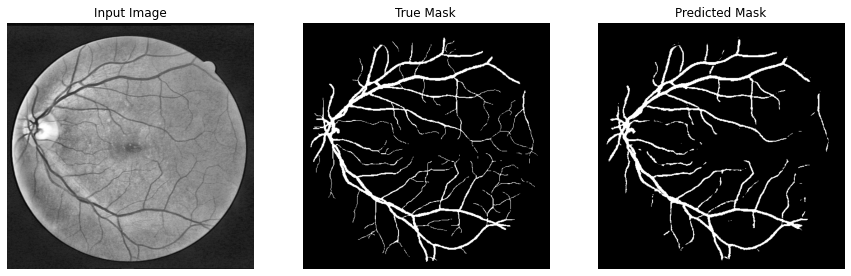


Sample Prediction after epoch 396


Epoch 00396: val_accuracy did not improve from 0.95889
Epoch 397/400
2/2 [==============================] - 1s 585ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00397: val_accuracy did not improve from 0.95889
Epoch 398/400
2/2 [==============================] - 1s 602ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00398: val_accuracy did not improve from 0.95889
Epoch 399/400
2/2 [==============================] - 1s 597ms/step - loss: 0.1950 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00399: val_accuracy did not improve from 0.95889
Epoch 400/400
2/2 [==============================] - 1s 587ms/step - loss: 0.1949 - accuracy: 0.9675 - val_loss: 0.2136 - val_accuracy: 0.9559

Epoch 00400: val_accuracy did not improve from 0.95889


In [11]:
from keras.callbacks import Callback, ModelCheckpoint, ReduceLROnPlateau

# define optomizer
optim = keras.optimizers.Adam(0.0003)
bce   = keras.losses.BinaryCrossentropy()
metrics = ["accuracy"]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)

filepath = './unet_backbone_vgg19.h5'
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
rlrop = ReduceLROnPlateau(monitor='val_accuracy', mode='max', patience=5, factor=0.6, min_lr=1e-7, verbose=1)

history = model.fit(
    train_dataset,
    epochs=400,
    callbacks=[DisplayCallback(train_dataset), checkpoint, rlrop],
    validation_data=valid_dataset
)

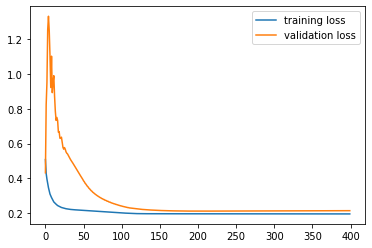

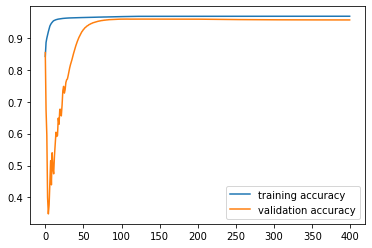

In [12]:
# plot the loss
plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.legend()
plt.show()
#plt.savefig('LossVal_loss')

# plot the accuracy
plt.plot(history.history['accuracy'], label='training accuracy')
plt.plot(history.history['val_accuracy'], label='validation accuracy')
plt.legend()
plt.show()
#plt.savefig('AccVal_acc')

In [13]:
tf.keras.models.save_model(model, './unet_backbone2_vgg19.h5')

## Evaluating Functions

In [14]:
def my_dice(target, prediction):
 intersection = np.logical_and(target, prediction)
 union = np.logical_or(target, prediction)
 dice = (2*np.sum(intersection))/(np.sum(union)+np.sum(intersection))
 return dice

In [15]:
def jaccard(target, prediction):
    intersection = np.logical_and(target, prediction)
    union = np.logical_or(target, prediction)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

In [16]:
def quick_plot(img, msk):
    plt.figure(figsize=(10, 10))   
    plt.subplot(1, 2, 1)
    plt.axis('off')
    plt.imshow(img)
    plt.title('image')

    plt.subplot(1, 2, 2)
    plt.axis('off')
    plt.imshow(msk)
    plt.title('mask')
    plt.show()


In [17]:
from tensorflow.keras.models import load_model

model = load_model('./unet_backbone_vgg19.h5') 

## **Evaluating on DRIVE**

In [18]:
test_masks = np.concatenate([y for x, y in valid_dataset], axis=0)
masks = test_masks.ravel()

In [19]:
test_imgs = np.concatenate([x for x, y in valid_dataset], axis=0)
predictions = model.predict(test_imgs)
predictions.shape

(5, 512, 512, 1)

In [20]:
y_pred = predictions.ravel()
y_pred = (y_pred > 0.5).astype('int32')
y_pred

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [21]:
from sklearn.metrics import classification_report
print(classification_report(masks, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98   1194312
           1       0.82      0.69      0.75    116408

    accuracy                           0.96   1310720
   macro avg       0.90      0.84      0.86   1310720
weighted avg       0.96      0.96      0.96   1310720



In [22]:
print('The Jaccard Score is: ', jaccard(y_pred, masks))

The Jaccard Score is:  0.5974810819694174


In [23]:
print('The Dice Score is: ', my_dice(y_pred, masks))

The Dice Score is:  0.7480289922843114


## Sample Prediction

(-0.5, 511.5, 511.5, -0.5)

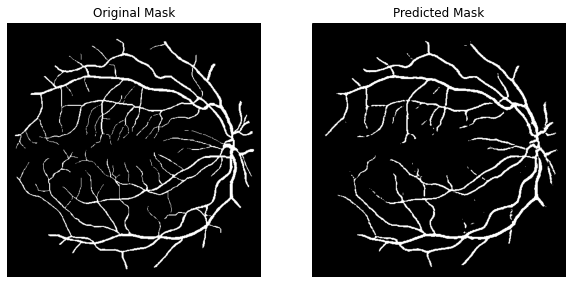

In [24]:
image = test_imgs[4]
mask = test_masks[4]
image = np.expand_dims(image, axis=0)
pred_mask = model.predict(image)
pred_mask = (pred_mask > 0.5).astype('int32')
plt.figure(figsize=(10,5))
plt.subplot(121)
plt.title('Original Mask')
plt.imshow(mask, cmap='gray')
plt.axis('off')
plt.subplot(122)
plt.title('Predicted Mask')
plt.imshow(pred_mask[0], cmap='gray')
plt.axis('off')

# HRF


The **HRF** dataset comes with retina image and corresponding vessel target and retina mask itself. See the code below.

In [25]:
hrf_dir = '../input/retinal-vessel-segmentation/HRF'

input_data = os.path.join(hrf_dir, 'images')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


target_data = os.path.join(hrf_dir, 'mask')
masks1 = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

target_data = os.path.join(hrf_dir, 'manual1')
masks2 = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

len(images), len(masks1), len(masks2)

(45, 45, 45)

01_dr.JPG  |  01_dr_mask.tif  |  01_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


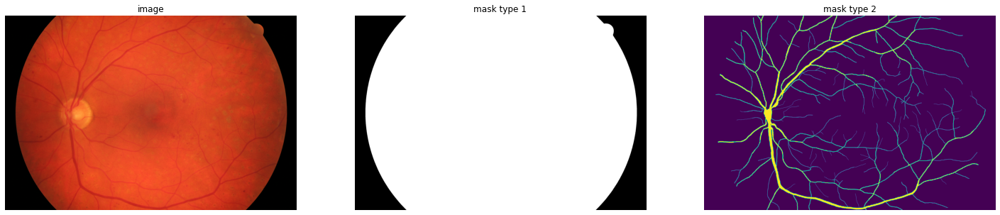

/01_g.jpg  |  /01_g_mask.tif  |  /01_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


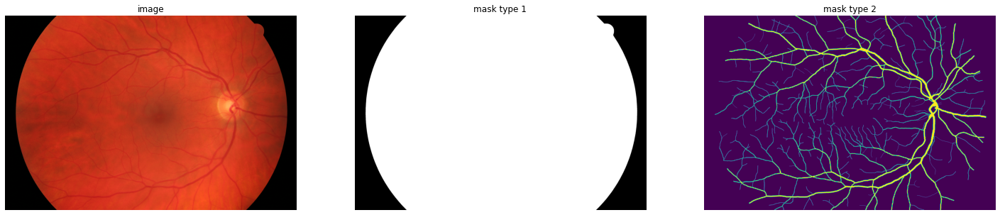

/01_h.jpg  |  /01_h_mask.tif  |  /01_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


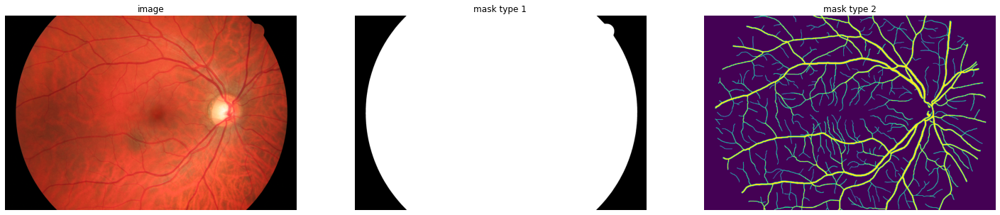

02_dr.JPG  |  02_dr_mask.tif  |  02_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


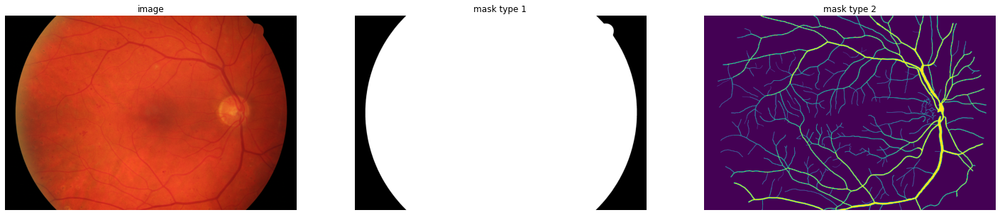

/02_g.jpg  |  /02_g_mask.tif  |  /02_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


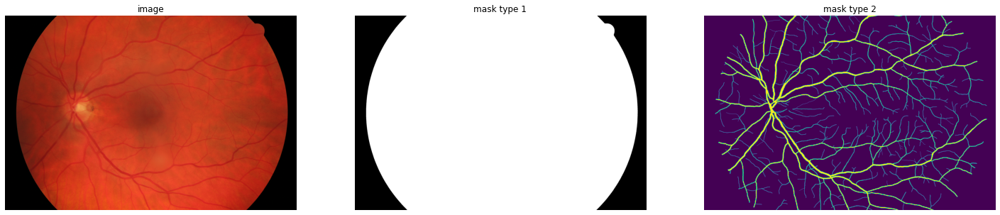

/02_h.jpg  |  /02_h_mask.tif  |  /02_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


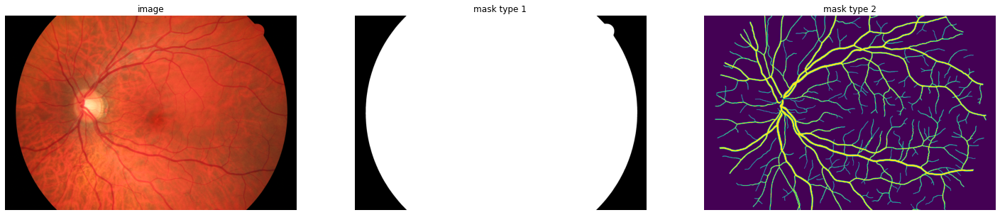

03_dr.JPG  |  03_dr_mask.tif  |  03_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


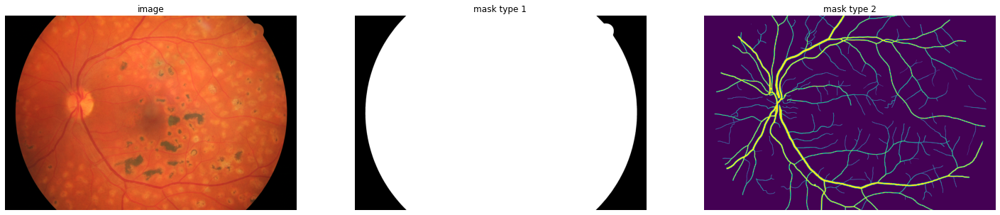

/03_g.jpg  |  /03_g_mask.tif  |  /03_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


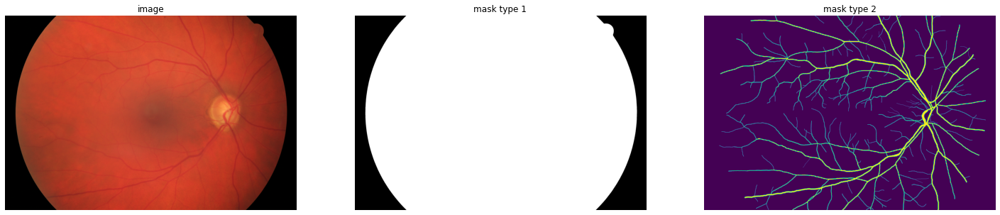

/03_h.jpg  |  /03_h_mask.tif  |  /03_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


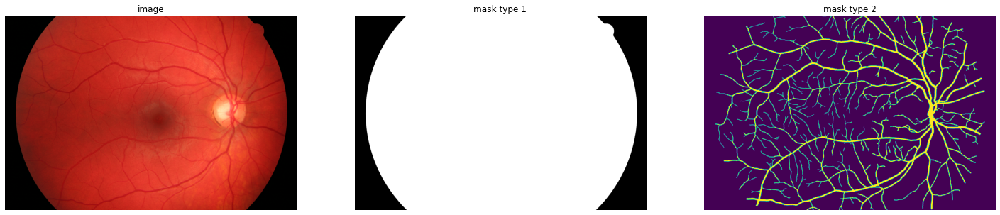

04_dr.JPG  |  04_dr_mask.tif  |  04_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


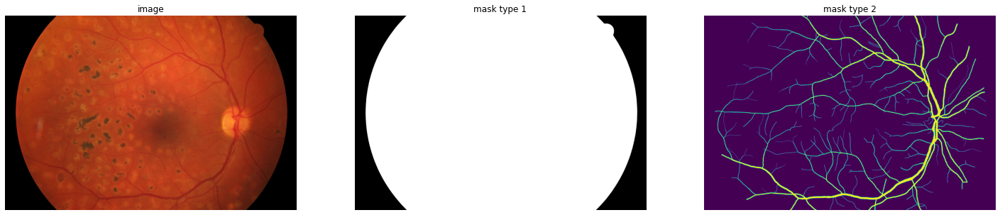

/04_g.jpg  |  /04_g_mask.tif  |  /04_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


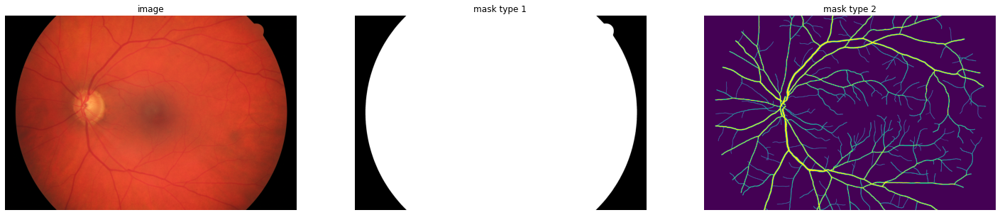

/04_h.jpg  |  /04_h_mask.tif  |  /04_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


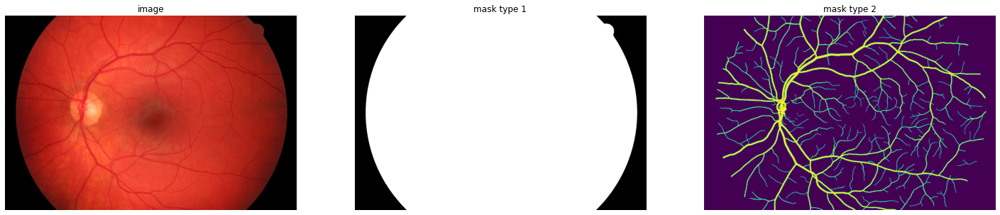

05_dr.JPG  |  05_dr_mask.tif  |  05_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


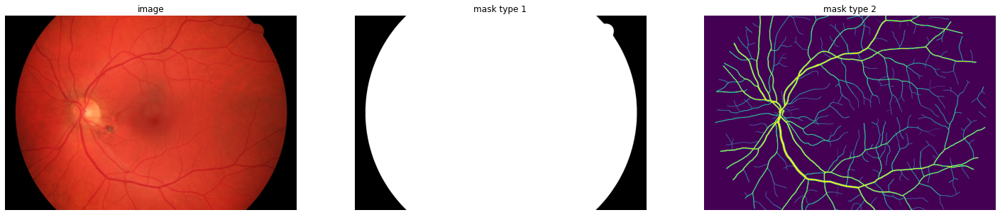

/05_g.jpg  |  /05_g_mask.tif  |  /05_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


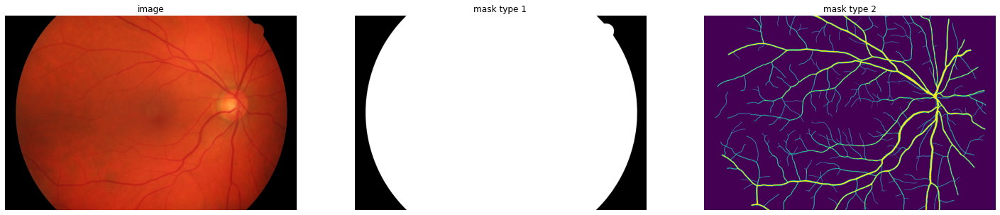

/05_h.jpg  |  /05_h_mask.tif  |  /05_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


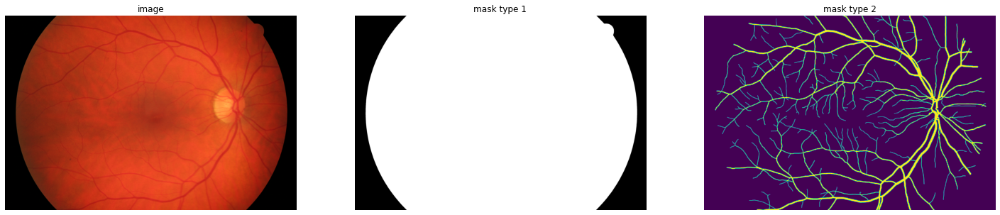

06_dr.JPG  |  06_dr_mask.tif  |  06_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


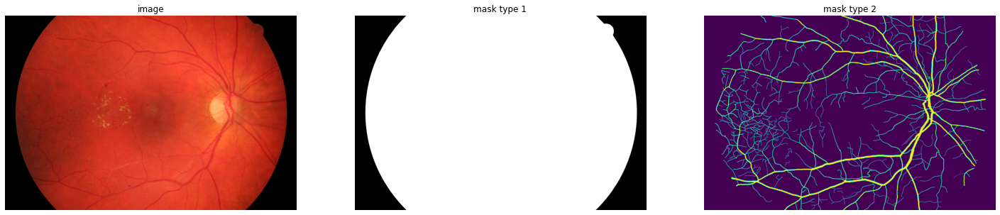

/06_g.jpg  |  /06_g_mask.tif  |  /06_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


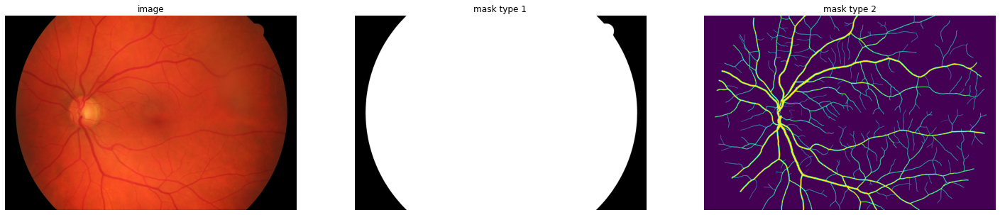

/06_h.jpg  |  /06_h_mask.tif  |  /06_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


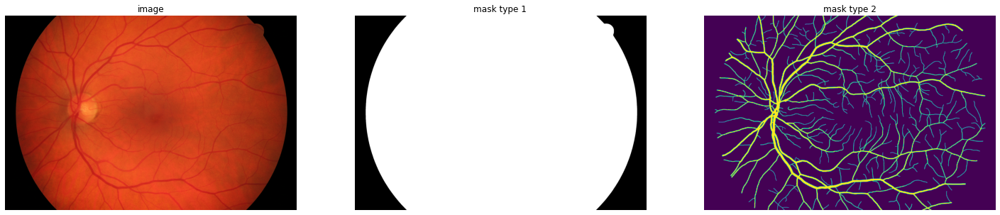

07_dr.JPG  |  07_dr_mask.tif  |  07_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


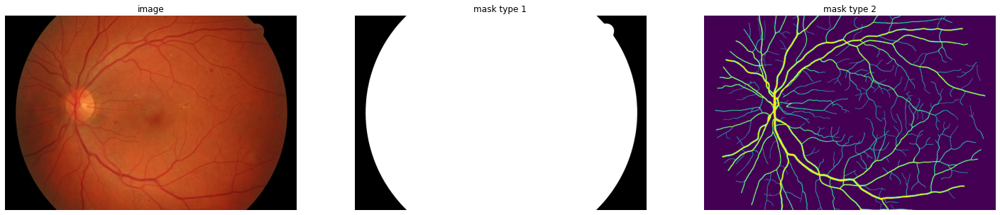

/07_g.jpg  |  /07_g_mask.tif  |  /07_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


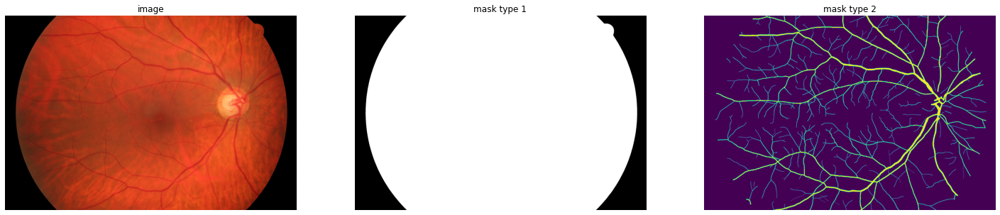

/07_h.jpg  |  /07_h_mask.tif  |  /07_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


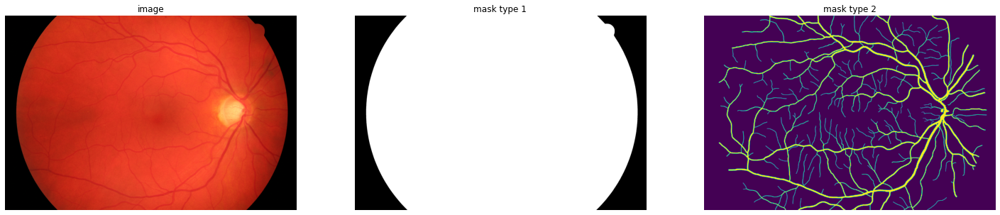

08_dr.JPG  |  08_dr_mask.tif  |  08_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


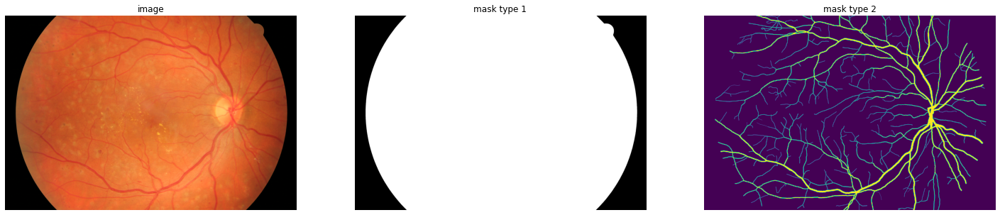

/08_g.jpg  |  /08_g_mask.tif  |  /08_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


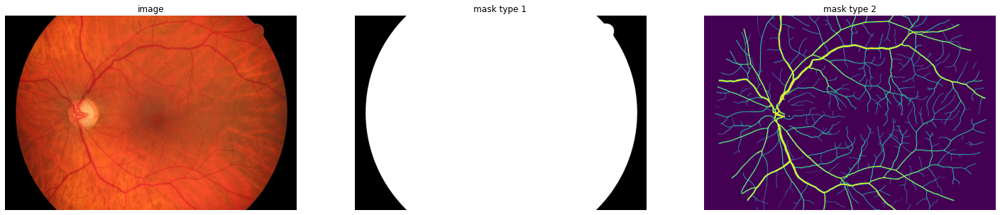

/08_h.jpg  |  /08_h_mask.tif  |  /08_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


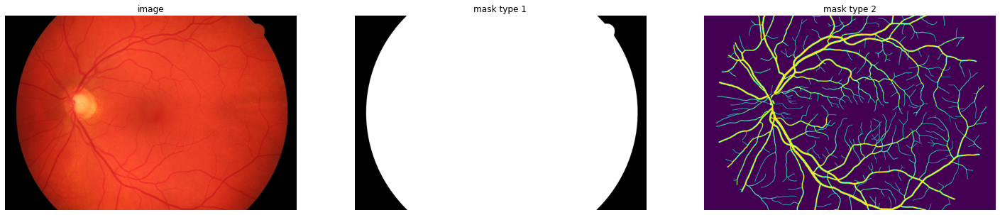

09_dr.JPG  |  09_dr_mask.tif  |  09_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


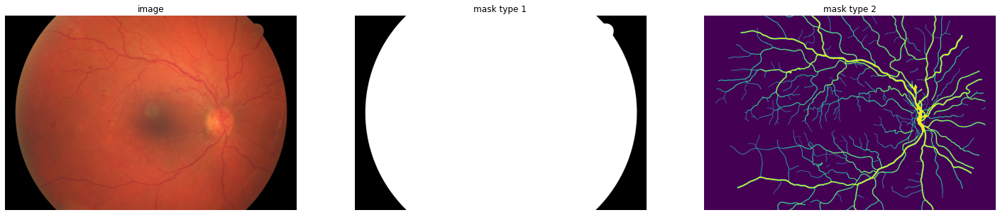

/09_g.jpg  |  /09_g_mask.tif  |  /09_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


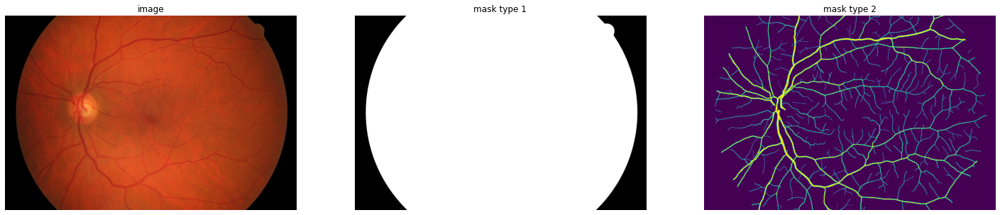

/09_h.jpg  |  /09_h_mask.tif  |  /09_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


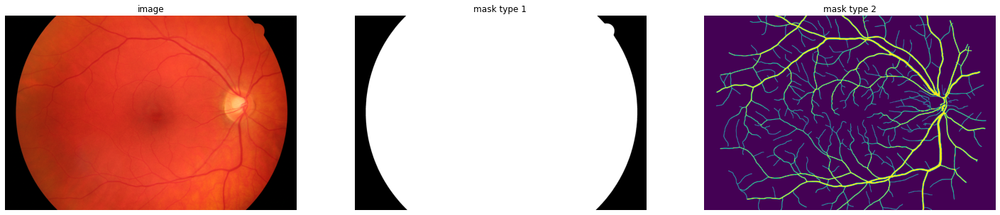

10_dr.JPG  |  10_dr_mask.tif  |  10_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


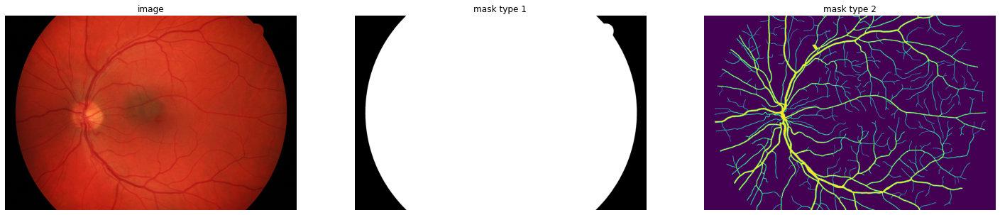

/10_g.jpg  |  /10_g_mask.tif  |  /10_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


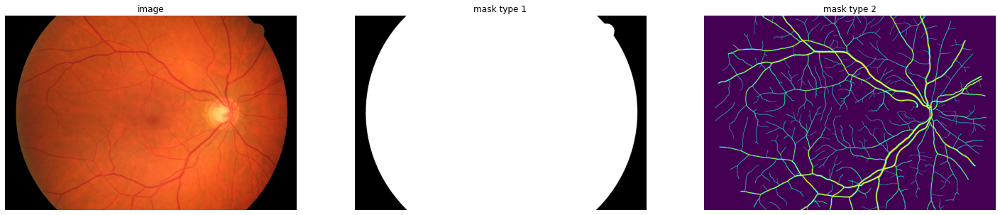

/10_h.jpg  |  /10_h_mask.tif  |  /10_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


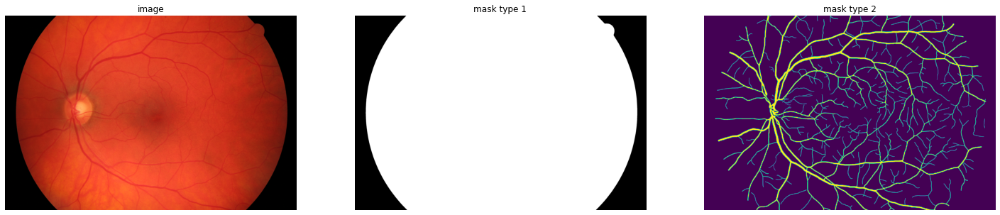

11_dr.JPG  |  11_dr_mask.tif  |  11_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


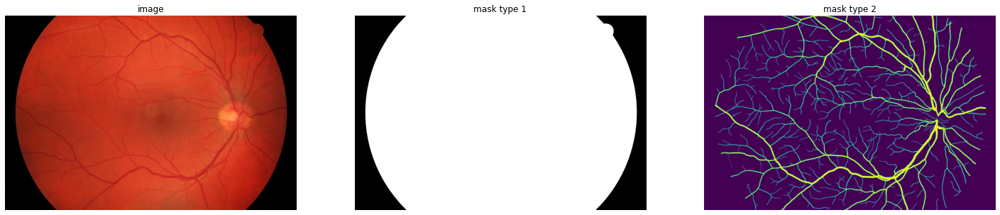

/11_g.jpg  |  /11_g_mask.tif  |  /11_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


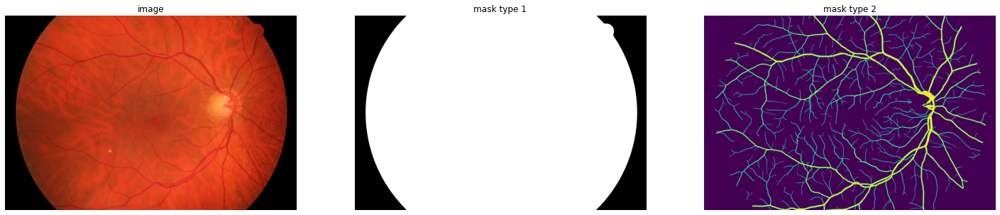

/11_h.jpg  |  /11_h_mask.tif  |  /11_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


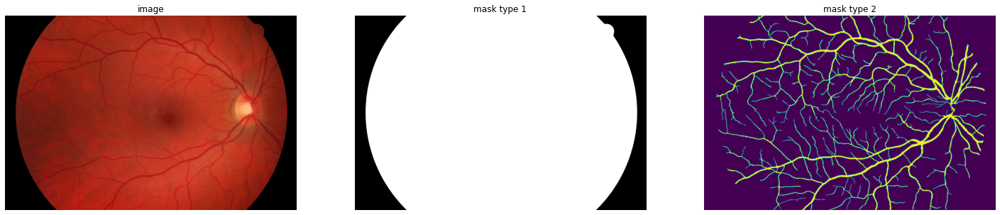

12_dr.JPG  |  12_dr_mask.tif  |  12_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


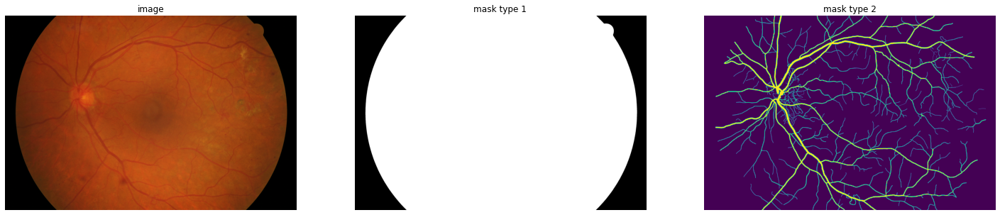

/12_g.jpg  |  /12_g_mask.tif  |  /12_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


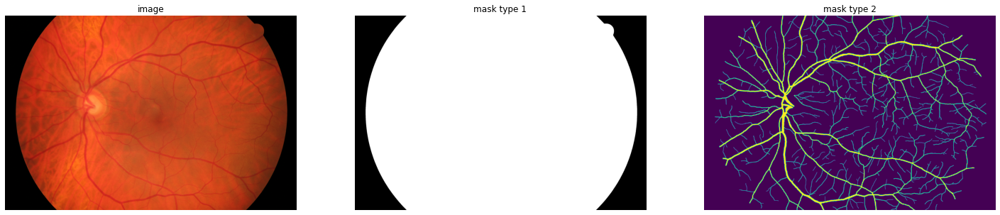

/12_h.jpg  |  /12_h_mask.tif  |  /12_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


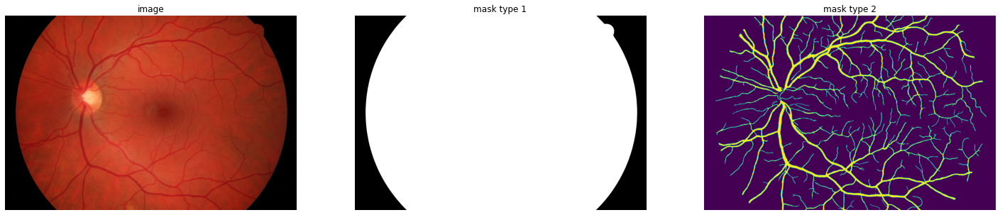

13_dr.JPG  |  13_dr_mask.tif  |  13_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


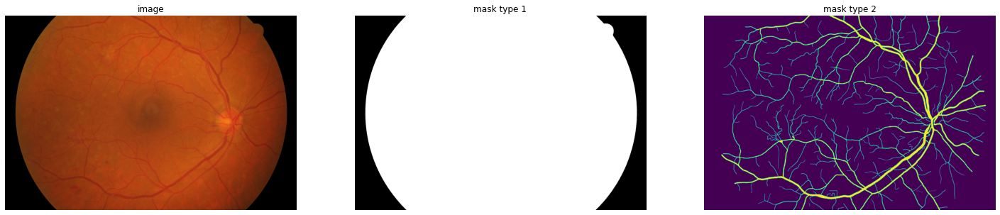

/13_g.jpg  |  /13_g_mask.tif  |  /13_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


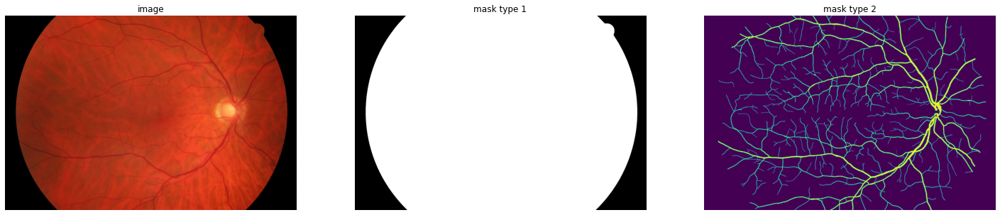

/13_h.jpg  |  /13_h_mask.tif  |  /13_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


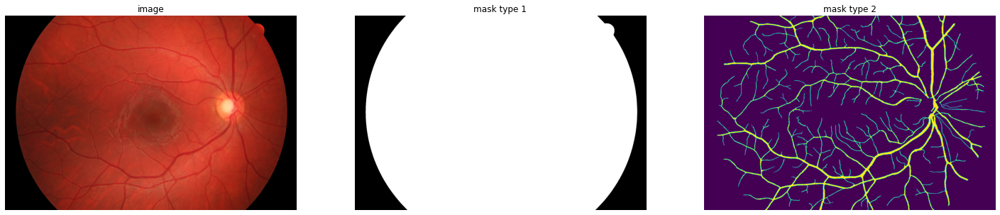

14_dr.JPG  |  14_dr_mask.tif  |  14_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


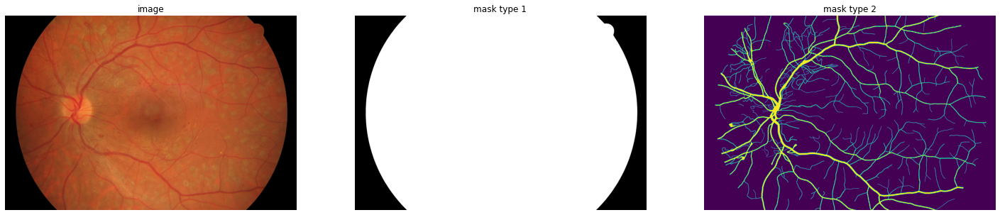

/14_g.jpg  |  /14_g_mask.tif  |  /14_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


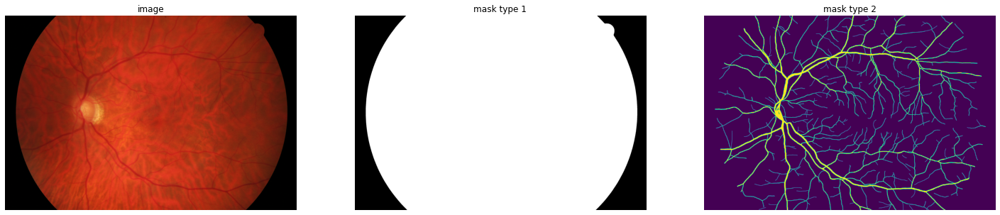

/14_h.jpg  |  /14_h_mask.tif  |  /14_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


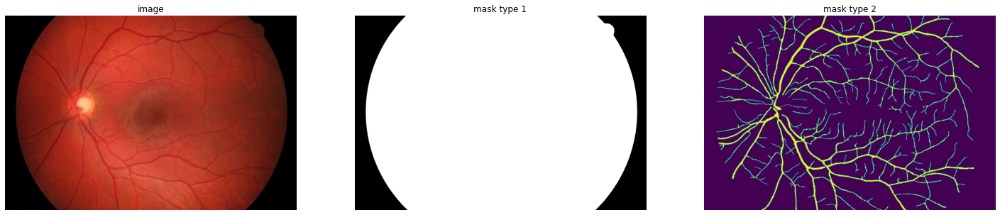

15_dr.JPG  |  15_dr_mask.tif  |  15_dr.tif
(3504, 2336) (3504, 2336) (3504, 2336)


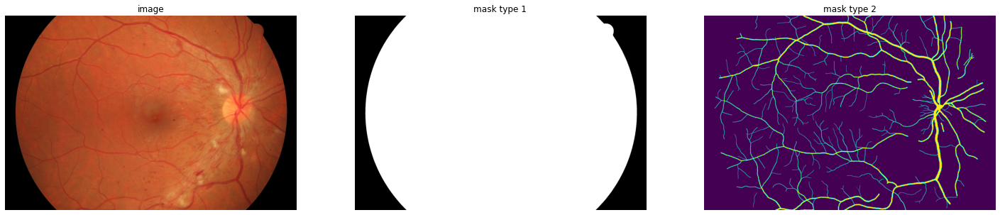

/15_g.jpg  |  /15_g_mask.tif  |  /15_g.tif
(3504, 2336) (3504, 2336) (3504, 2336)


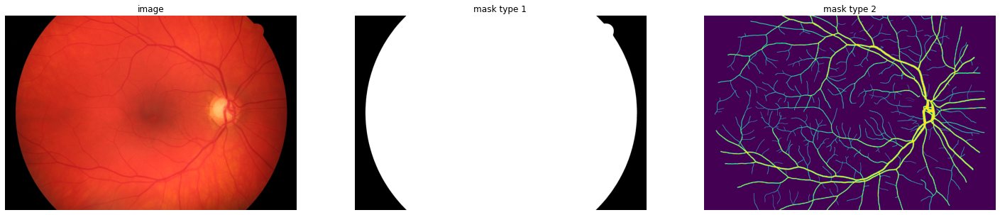

/15_h.jpg  |  /15_h_mask.tif  |  /15_h.tif
(3504, 2336) (3504, 2336) (3504, 2336)


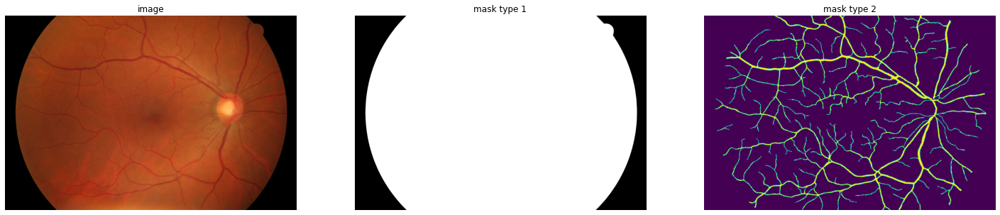

In [26]:
def quick_plot(img, msk1, msk2):
    plt.figure(figsize=(25, 25))   
    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(img)
    plt.title('image')

    plt.subplot(1, 3, 2)
    plt.axis('off')
    plt.imshow(msk1)
    plt.title('mask type 1')

    plt.subplot(1, 3, 3)
    plt.axis('off')
    plt.imshow(msk2)
    plt.title('mask type 2')
    plt.show() 


for img, msk1, msk2 in zip(images, masks1, masks2):
    print(img[-9:],' | ', msk1[-14:], ' | ', msk2[-9:])
    
    # read files 
    read_img  = Image.open(img)
    read_msk1 = Image.open(msk1)
    read_msk2 = Image.open(msk2)
    
    # plot them 
    print(read_img.size, read_msk1.size, read_msk2.size)
    quick_plot(read_img, read_msk1, read_msk2)

## Preprocess

In [27]:
import cv2
from PIL import Image

processed_path = './Processed_images_HRF'

os.mkdir(path=processed_path)
directory = '../input/retinal-vessel-segmentation/HRF/images/'
for fname in os.listdir(directory):
    image = plt.imread(directory + fname)
    image = image[:,:,1]
    processed_img = preprocess(image)
    processed_img = Image.fromarray((processed_img * 255).astype(np.uint8))
    processed_img.save(processed_path + '/' + fname)

In [28]:
input_data = os.path.join('./', 'Processed_images_HRF')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir('./Processed_images_HRF')
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

In [29]:
IMAGE_SIZE = 512
BATCH_SIZE = 1

def read_files(image_path):
    image = tf.io.read_file(image_path)
    image = tf.io.decode_image(image) # out: (h, w, 4)
    image = image[:,:,:3] # out: (h, w, 3)
    image.set_shape([None, None, 3])
    image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    image = image / 255.
    return image

def load_data(image_list):
    image = read_files(image_list)
    return image

def data_generator(image_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset

test_dataset = data_generator(images)
test_dataset

<BatchDataset shapes: (None, 512, 512, 3), types: tf.float32>

In [30]:
IMAGE_SIZE = 512
BATCH_SIZE = 1

def read_files(mask_path):
    mask = tf.io.read_file(mask_path)
    mask = tfio.experimental.image.decode_tiff(mask) # out: (1, h, w, 3)
    mask = mask[:,:,:3] # out: (h, w, 3)
    mask = tf.image.rgb_to_grayscale(mask) # out: (h, w, 1)
    mask = tf.divide(mask, 128)
    mask.set_shape([None, None, 1])
    mask = tf.image.resize(images=mask, size=[IMAGE_SIZE, IMAGE_SIZE])
    mask = tf.cast(mask, tf.int32)
    return mask

def load_data(mask_list):
    mask = read_files(mask_list)
    return mask

def data_generator(mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset

mask_dataset = data_generator(masks2)
mask_dataset

<BatchDataset shapes: (None, 512, 512, 1), types: tf.int32>

In [31]:
predictions = model.predict(test_dataset)
predictions.shape

(45, 512, 512, 1)

In [32]:
y_pred = predictions.ravel()
y_pred = (y_pred > 0.5).astype('int32')
y_pred

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [33]:
masks = mask_dataset.unbatch()
masks = list(masks.as_numpy_iterator())
test_masks = np.array(masks)
masks = test_masks.ravel()
masks

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [34]:
jaccard_score = jaccard(y_pred, masks)
dice = my_dice(y_pred, masks)

print('The Jaccard Score is: ', jaccard_score)
print('The Dice Score is: ', dice)
print(classification_report(masks, y_pred))

The Jaccard Score is:  0.48755322891866604
The Dice Score is:  0.6555102962911503
              precision    recall  f1-score   support

           0       0.97      0.97      0.97  10887778
           1       0.63      0.68      0.66    908702

    accuracy                           0.94  11796480
   macro avg       0.80      0.82      0.81  11796480
weighted avg       0.95      0.94      0.95  11796480



## Sample Prediction

In [35]:
test_imgs = np.concatenate([x for x in test_dataset], axis=0)

(-0.5, 511.5, 511.5, -0.5)

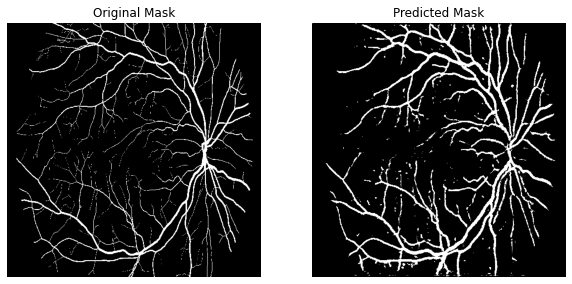

In [36]:
image = test_imgs[21]
mask = test_masks[21]
image = np.expand_dims(image, axis=0)
pred_mask = model.predict(image)
pred_mask = (pred_mask > 0.5).astype('int32')
plt.figure(figsize=(10,5))
plt.subplot(121)
plt.title('Original Mask')
plt.imshow(mask, cmap='gray')
plt.axis('off')
plt.subplot(122)
plt.title('Predicted Mask')
plt.imshow(pred_mask[0], cmap='gray')
plt.axis('off')

# CHASE DB1

This data set comes with both retina image and corresponding target mask. Note that, for each retina image, there are two mask. Below, in data loading time, we only pick one mask agains the retina image. 

In [37]:
hrf_dir = '../input/retinal-vessel-segmentation/CHASE_DB1'


input_data = os.path.join(hrf_dir, 'Images')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


target_data = os.path.join(hrf_dir, 'Masks')
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith('_2ndHO.png') and not fname.startswith(".") # _2ndHO.png, _1stHO.png
    ]
)


len(images), len(masks)

(28, 28)

## Preprocess

In [38]:
import cv2
from PIL import Image

processed_path = './Processed_images_ChaseDB1'

os.mkdir(path=processed_path)
directory = '../input/retinal-vessel-segmentation/CHASE_DB1/Images/'
for fname in os.listdir(directory):
    image = plt.imread(directory + fname)
    image = image[:,:,1]
    processed_img = preprocess(image)
    processed_img = Image.fromarray((processed_img * 255).astype(np.uint8))
    processed_img.save(processed_path + '/' + fname)

In [39]:
input_data = os.path.join('./', 'Processed_images_ChaseDB1')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir('./Processed_images_ChaseDB1')
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

In [40]:
IMAGE_SIZE = 512
BATCH_SIZE = 1

def read_files(image_path):
    image = tf.io.read_file(image_path)
    image = tf.io.decode_image(image) # out: (h, w, 4)
    image = image[:,:,:3] # out: (h, w, 3)
    image.set_shape([None, None, 3])
    image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    image = image / 255.
    return image

def load_data(image_list):
    image = read_files(image_list)
    return image

def data_generator(image_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset

test_dataset = data_generator(images)
test_dataset

<BatchDataset shapes: (None, 512, 512, 3), types: tf.float32>

In [41]:
IMAGE_SIZE = 512
BATCH_SIZE = 1

def read_files(mask_path):
    mask = tf.io.read_file(mask_path)
    mask = tf.io.decode_gif(mask) # out: (1, h, w, 3)
    mask = tf.squeeze(mask) # out: (h, w, 3)
    mask = tf.image.rgb_to_grayscale(mask) # out: (h, w, 1)
    mask = tf.divide(mask, 128)
    mask.set_shape([None, None, 1])
    mask = tf.image.resize(images=mask, size=[IMAGE_SIZE, IMAGE_SIZE])
    mask = tf.cast(mask, tf.int32)
    return mask

def load_data(mask_list):
    mask = read_files(mask_list)
    return mask

def data_generator(mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset

mask_dataset = data_generator(masks)
mask_dataset

<BatchDataset shapes: (None, 512, 512, 1), types: tf.int32>

In [42]:
predictions = model.predict(test_dataset)
predictions.shape

(28, 512, 512, 1)

In [43]:
masks = mask_dataset.unbatch()
masks = list(masks.as_numpy_iterator())
test_masks = np.array(masks)
masks = test_masks.ravel()
masks

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [44]:
y_pred = predictions.ravel()
y_pred = (y_pred > 0.5).astype('int32')
y_pred

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [45]:
from sklearn.metrics import classification_report

print(classification_report(masks, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98   6852671
           1       0.71      0.52      0.60    487361

    accuracy                           0.95   7340032
   macro avg       0.84      0.75      0.79   7340032
weighted avg       0.95      0.95      0.95   7340032



In [46]:
jaccard_score = jaccard(y_pred, masks)
print('The Jaccard Score is: ', jaccard_score)

The Jaccard Score is:  0.42662781704950953


In [47]:
dice = my_dice(y_pred, masks)
# quick_plot(mask, pred_mask)
    
print('The Dice Score is: ', dice)

The Dice Score is:  0.5980926657267105


In [48]:
test_imgs = np.concatenate([x for x in test_dataset], axis=0)

(-0.5, 511.5, 511.5, -0.5)

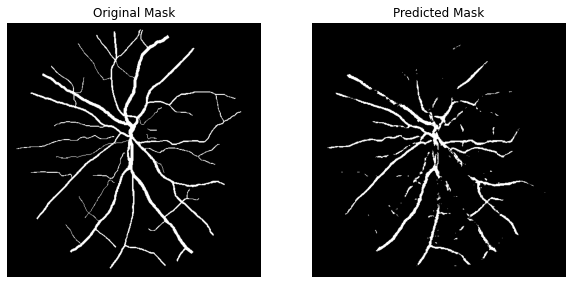

In [49]:
image = test_imgs[20]
mask = test_masks[20]
image = np.expand_dims(image, axis=0)
pred_mask = model.predict(image)
pred_mask = (pred_mask > 0.5).astype('int32')
plt.figure(figsize=(10,5))
plt.subplot(121)
plt.title('Original Mask')
plt.imshow(mask, cmap='gray')
plt.axis('off')
plt.subplot(122)
plt.title('Predicted Mask')
plt.imshow(pred_mask[0], cmap='gray')
plt.axis('off')

# Our High Quality Image Dataset

In [50]:
IMAGE_SIZE = 512

org_image = plt.imread('../input/our-retinal-fundus-image-dataset/High Quality Fundus Images/High Quality Fundus Images/8829 SYED AFZAL_20110401104656015.jpg')
image = org_image[:,:,1]
processed_img = preprocess(image)
# processed_img = Image.fromarray((processed_img * 255).astype(np.uint8))
processed_img = (processed_img * 255).astype(np.uint8)
image = tf.convert_to_tensor(processed_img)
image.set_shape([None, None, 3])
image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
image = image / 255.
image = np.expand_dims(image, axis=0)

(-0.5, 511.5, 511.5, -0.5)

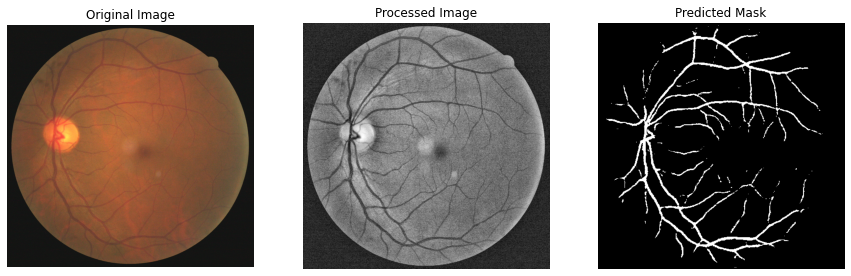

In [51]:
pred_mask = model.predict(image)
pred_mask = (pred_mask > 0.5).astype('int32')
plt.figure(figsize=(15,8))
plt.subplot(131)
plt.title('Original Image')
plt.imshow(org_image)
plt.axis('off')
plt.subplot(132)
plt.title('Processed Image')
plt.imshow(image[0], cmap='gray')
plt.axis('off')
plt.subplot(133)
plt.title('Predicted Mask')
plt.imshow(pred_mask[0], cmap='gray')
plt.axis('off')

# Our Low Quality Image Dataset

In [52]:
IMAGE_SIZE = 512

org_image = plt.imread('../input/our-retinal-fundus-image-dataset/HHFC Images/HHFC Images/EL 180624436112213.jpg')
image = org_image[:,:,1]
processed_img = preprocess(image)
# processed_img = Image.fromarray((processed_img * 255).astype(np.uint8))
processed_img = (processed_img * 255).astype(np.uint8)
image = tf.convert_to_tensor(processed_img)
image.set_shape([None, None, 3])
image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
image = image / 255.
image = np.expand_dims(image, axis=0)

(-0.5, 511.5, 511.5, -0.5)

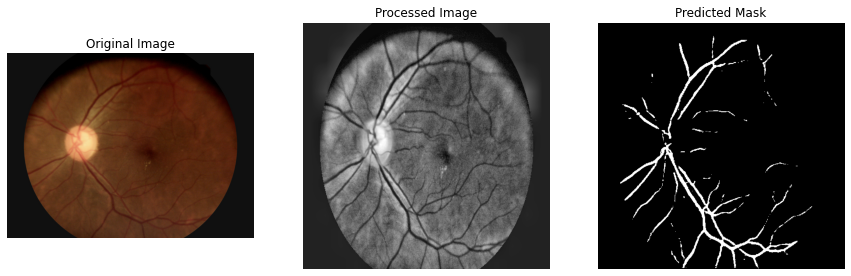

In [53]:
pred_mask = model.predict(image)
pred_mask = (pred_mask > 0.5).astype('int32')
plt.figure(figsize=(15,8))
plt.subplot(131)
plt.title('Original Image')
plt.imshow(org_image)
plt.axis('off')
plt.subplot(132)
plt.title('Processed Image')
plt.imshow(image[0], cmap='gray')
plt.axis('off')
plt.subplot(133)
plt.title('Predicted Mask')
plt.imshow(pred_mask[0], cmap='gray')
plt.axis('off')

<a href='./unet_backbone_vgg19.h5'>Download VGG19 Model</a>